### **Jupyter notebook containing a class for manually selecting ROI for the vibration responses at individual z-level.**

* shows the example usage for the data for the Biomechanics paper.

* load the DF/F map for the individual z-level.

* user manually selects the ROI (dendritic tips) at each z-level.

* will use DF/F map for the 800 Hz vibration (ROI will be aligned to the 800 Hz trial images). 800 Hz vibration response is generally the strongest response.

* unlike other notebook and analysis, this must be ran on a local computer (instead of google colab).

* after saving ROI, upload the ROIs to the google drive for the rest of the analysis.

* Summarized on 2021/09/15.


In [ ]:
#import the necessary packages.
import numpy as np
import os
import fnmatch
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter, center_of_mass
import pickle
from skimage.segmentation import watershed
from skimage.measure import regionprops_table
import cv2
import seaborn as sb
import pandas as pd
import IPython.display as Disp
from ipywidgets import widgets


### Define a class for manually selecting an ROI.

In [ ]:
class bbox_select():
    %matplotlib notebook 


    def __init__(self,im):
        self.im = im
        self.selected_points = []
        self.fig,ax = plt.subplots()
        self.img = ax.imshow(self.im.copy())
        self.ka = self.fig.canvas.mpl_connect('button_press_event', self.onclick)
        disconnect_button = widgets.Button(description="Disconnect mpl")
        Disp.display(disconnect_button)
        disconnect_button.on_click(self.disconnect_mpl)


        
    def poly_img(self,img,pts):
        pts = np.array(pts, np.int32)
        pts = pts.reshape((-1,1,2))
        cv2.polylines(img,[pts],True,(255,255,255),1)
        return img

    def onclick(self, event):
    #display(str(event))
        self.selected_points.append([event.xdata,event.ydata])
        if len(self.selected_points)>1:
            self.fig
            self.img.set_data(self.poly_img(self.im.copy(),self.selected_points))
    def disconnect_mpl(self,_):
        self.fig.canvas.mpl_disconnect(self.ka)

### Get the path to all the individual z-level maps files (we should have one 800 Hz trial for 50% amplitude). 

In [ ]:
#Get the file path to the merged DF/F map data.
maps_path=[]
#Path for the mered map files
path = '/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3'

#Go through all the files in a directory
for file_name in os.listdir(path):
    if fnmatch.fnmatch(file_name,'*_maps'):
        maps_path.append(os.path.join(path,file_name))
        
maps_path_sorted=sorted(maps_path)

#Print to make sure
for f in maps_path_sorted:
    print(f)

print(len(maps_path_sorted))

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210712-1-Iav-tdt-7F_00017GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210712-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-1-Iav-tdt-7F_00005GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210715-1-Iav-tdt-7F_00019GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps
/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/

### Load the file for the 20210712-1

* initialize the numpy array for the mask

In [ ]:
#load the merged maps.
trial_number = 0    


#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)
    
#    
#

### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


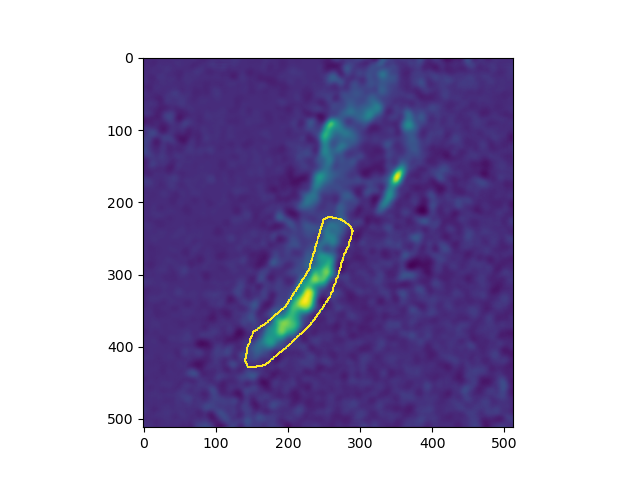

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


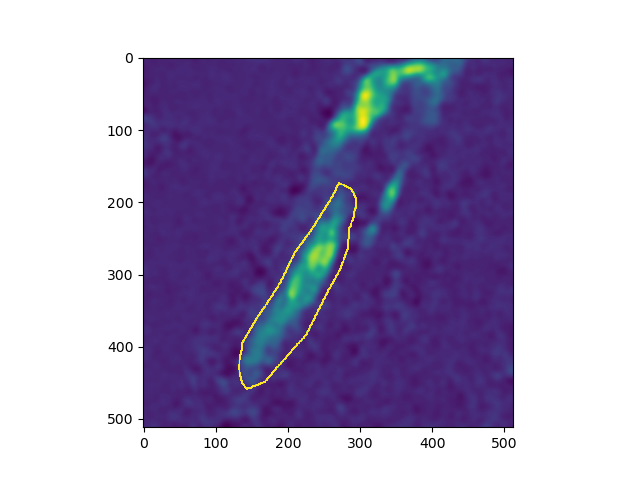

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


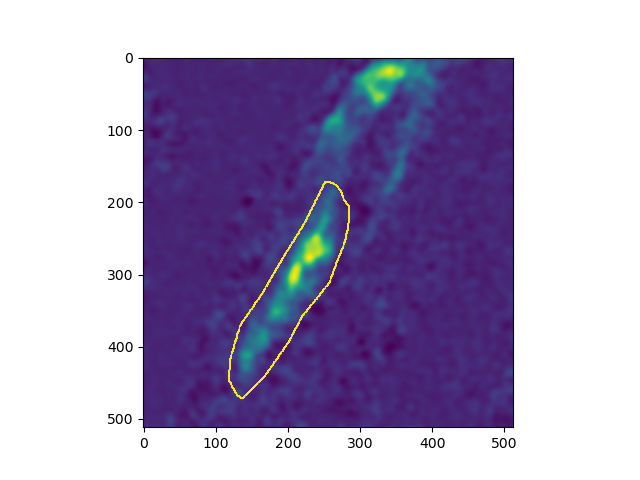

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


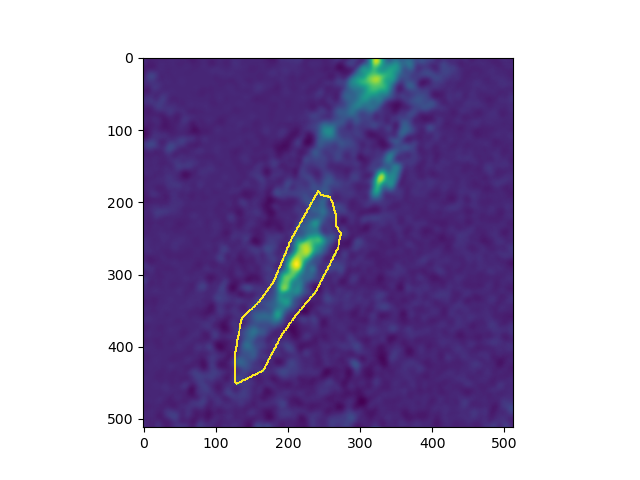

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


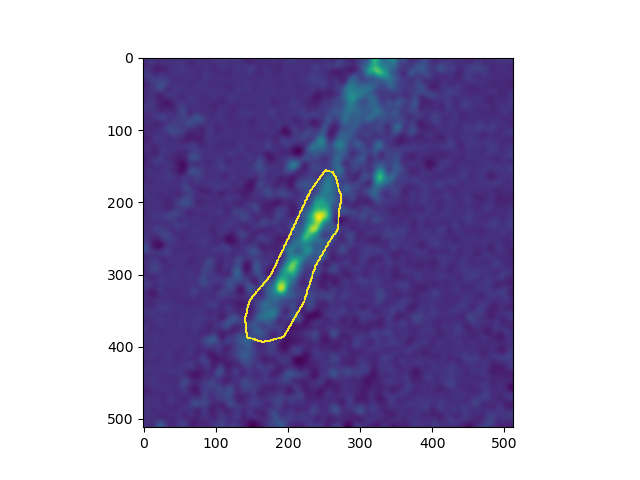

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


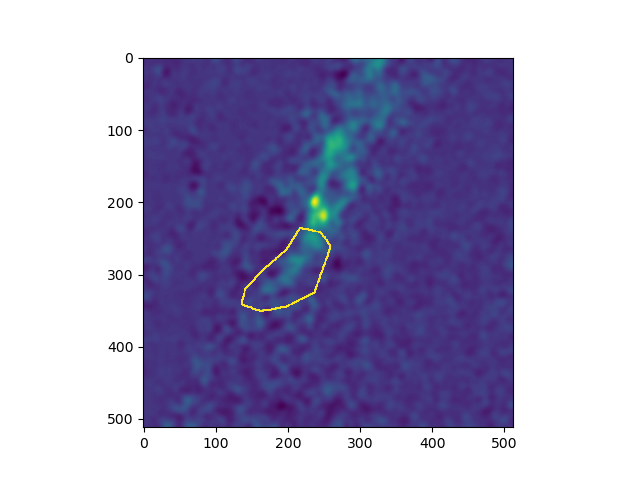

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210712-1-Iav-tdt-7F_00017GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 1    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210712-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


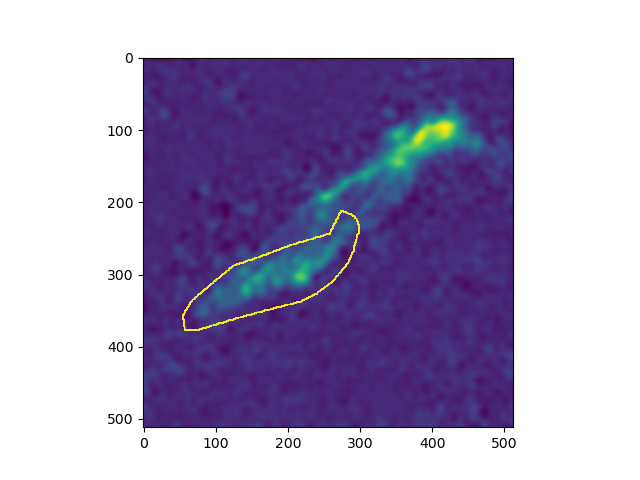

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


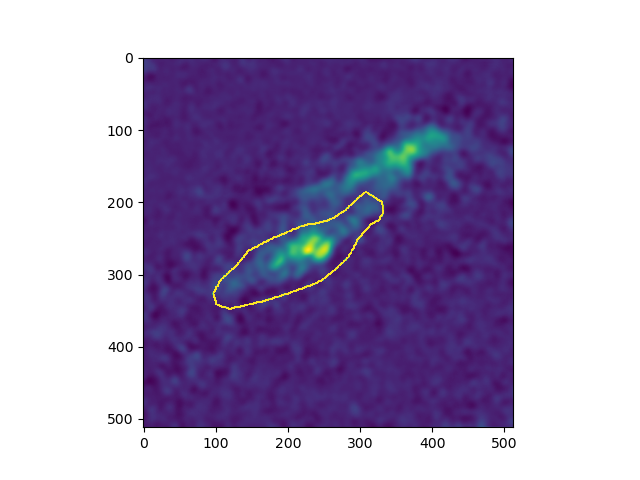

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


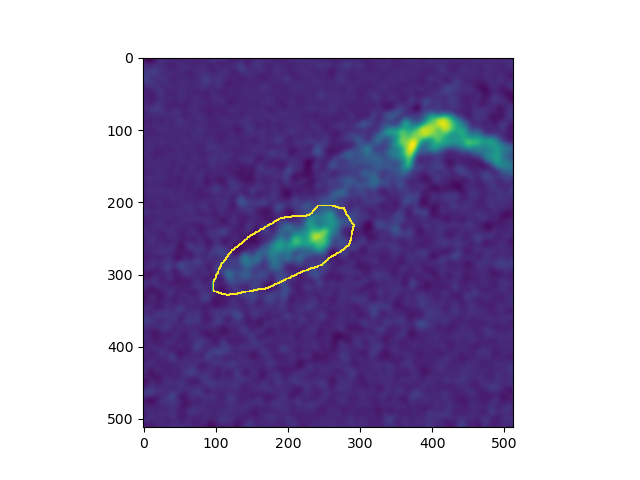

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


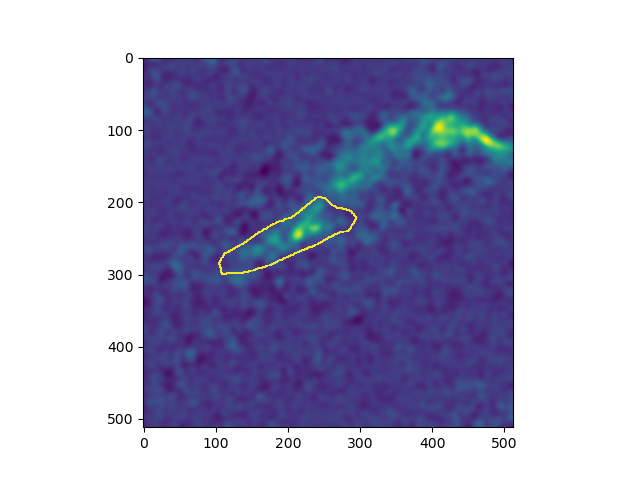

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


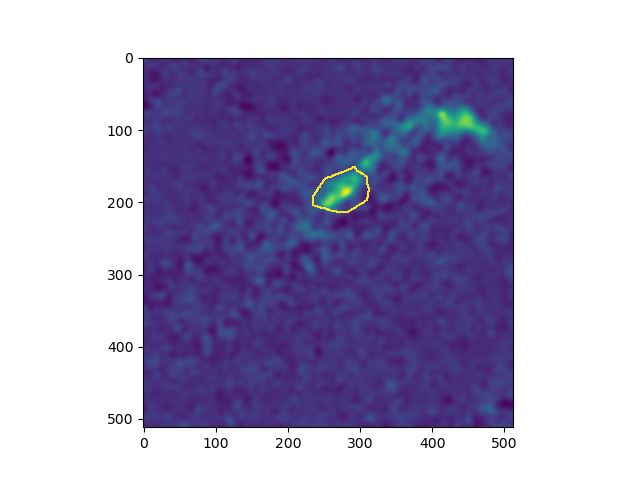

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


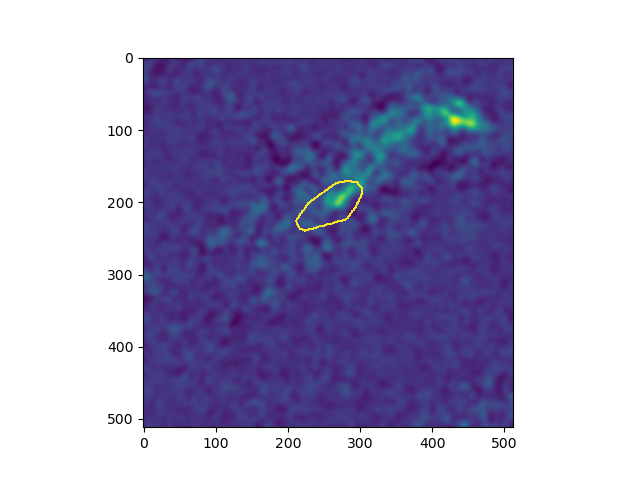

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210712-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 2    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-1-Iav-tdt-7F_00005GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


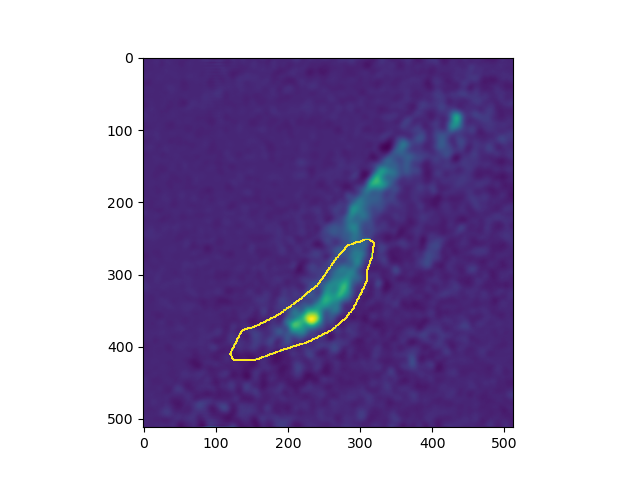

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


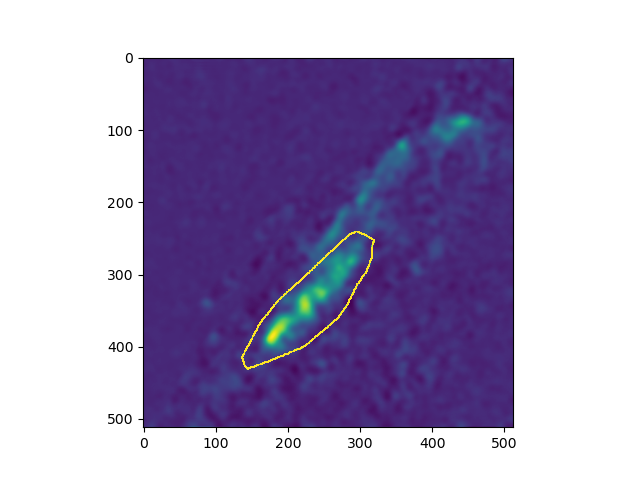

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


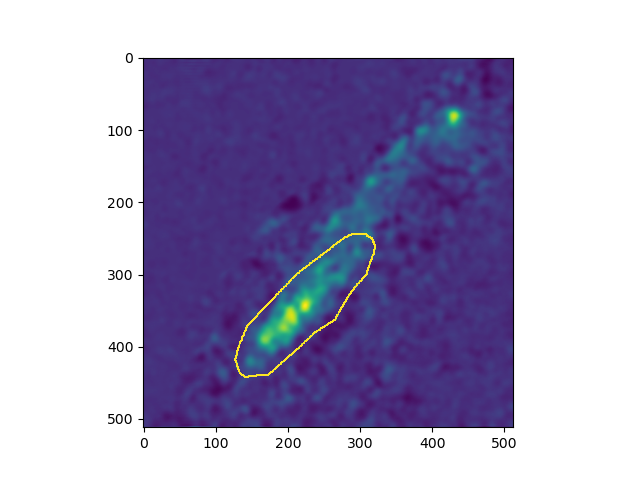

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


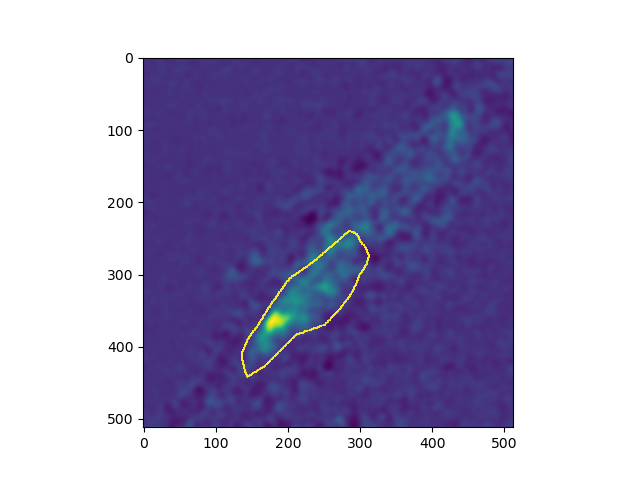

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


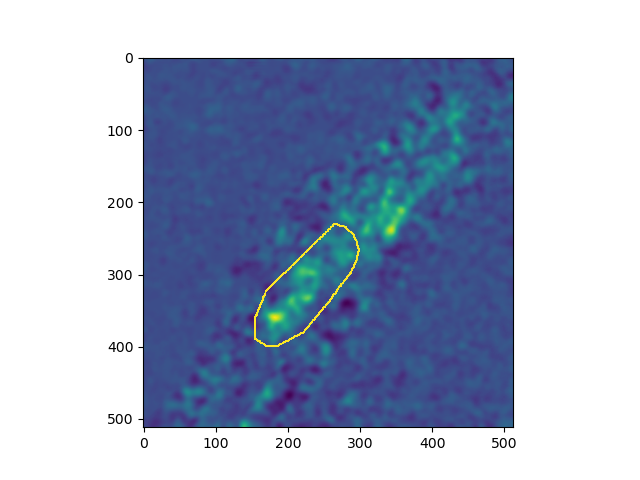

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


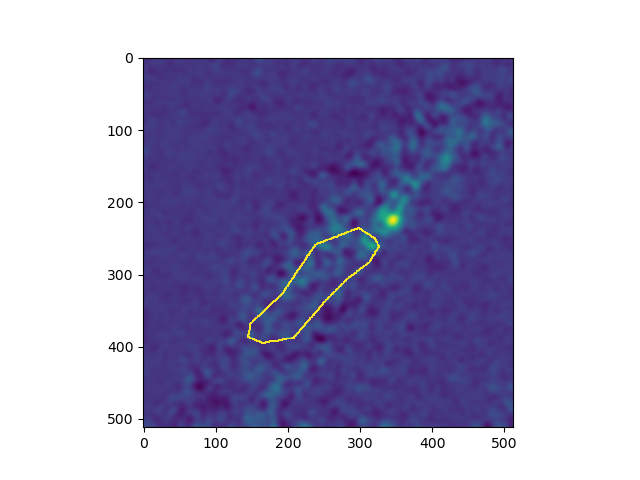

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-1-Iav-tdt-7F_00005GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 3    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


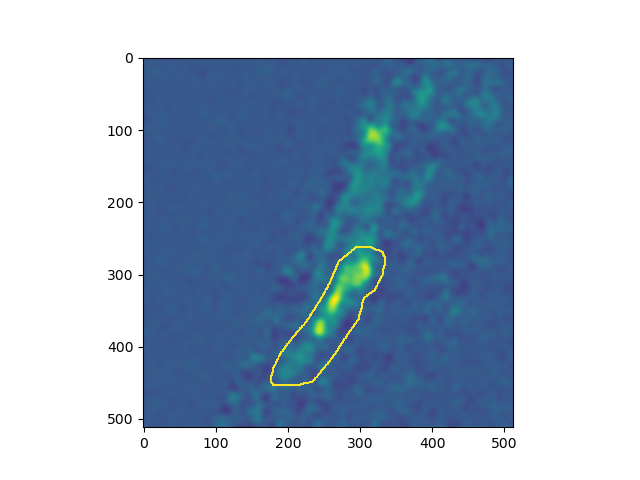

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


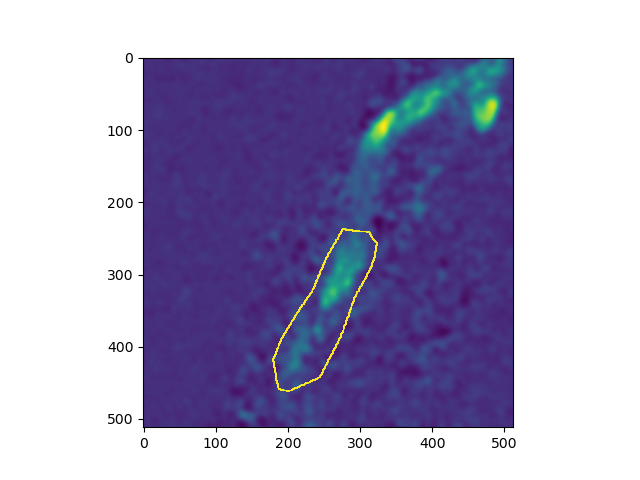

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


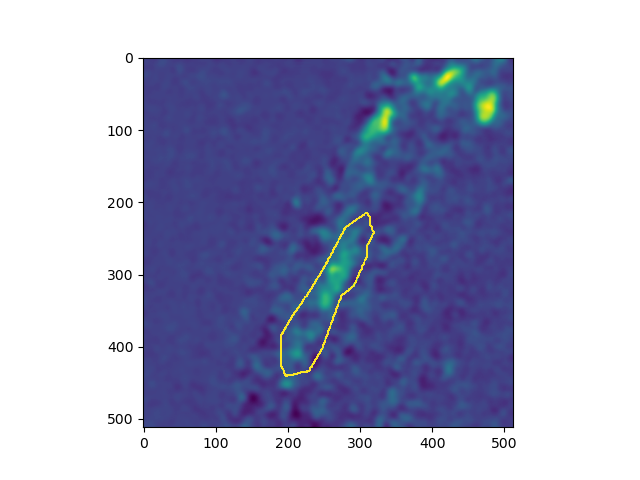

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


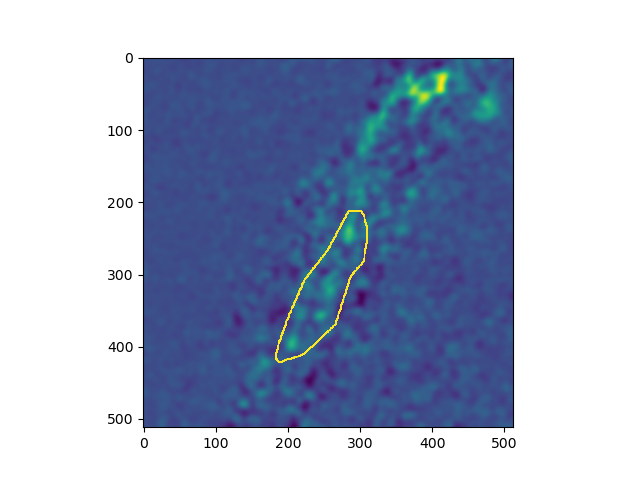

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


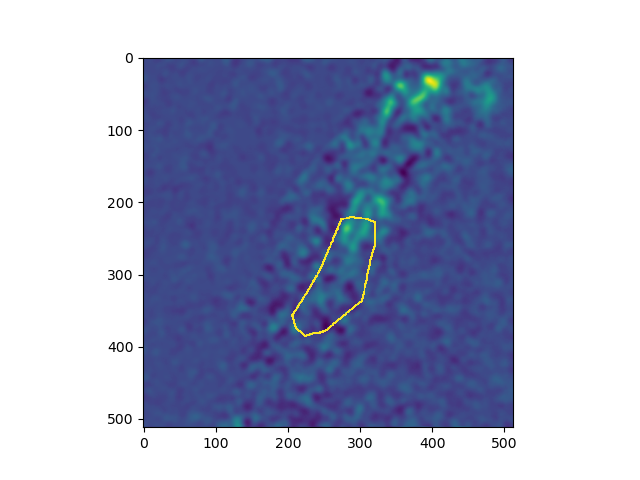

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


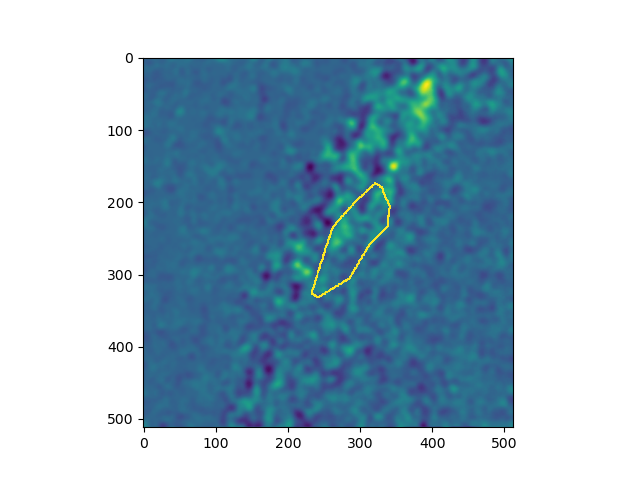

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210713-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 4    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210715-1-Iav-tdt-7F_00019GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


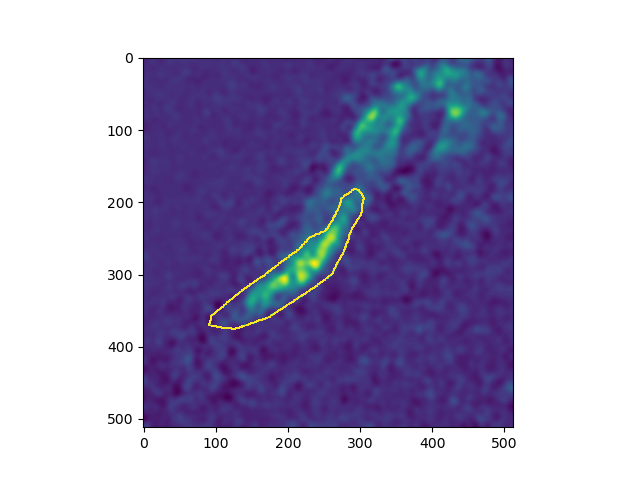

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


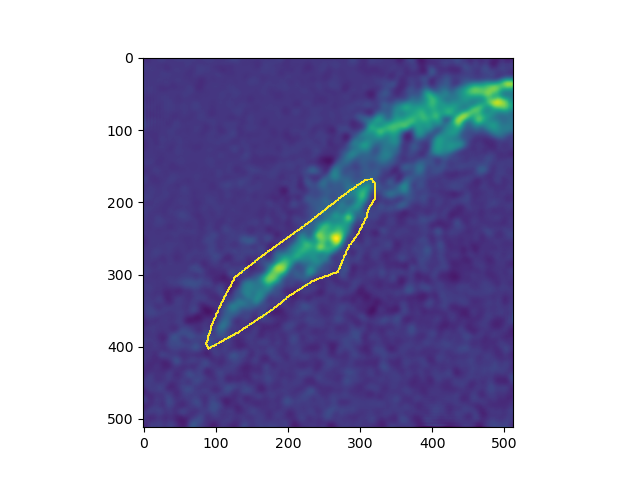

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


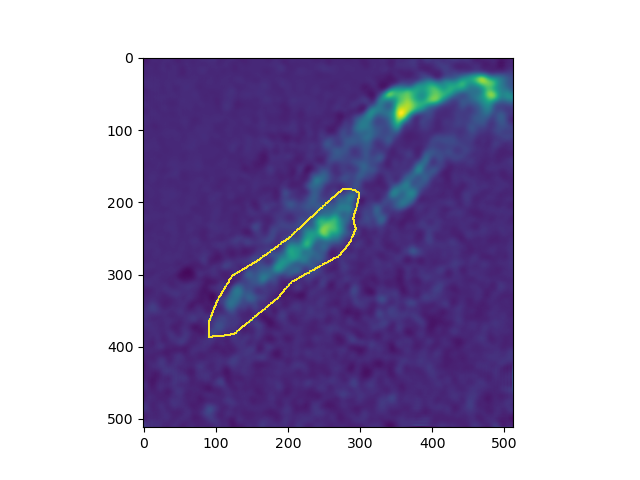

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


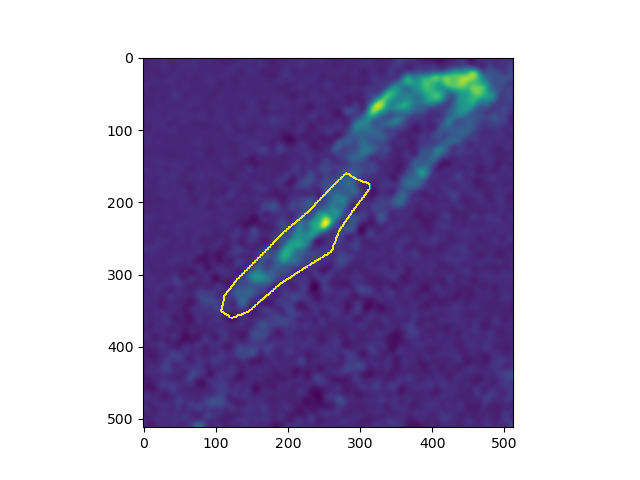

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


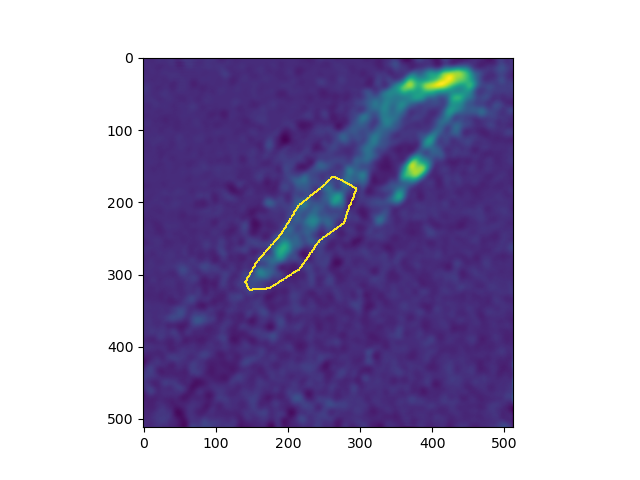

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


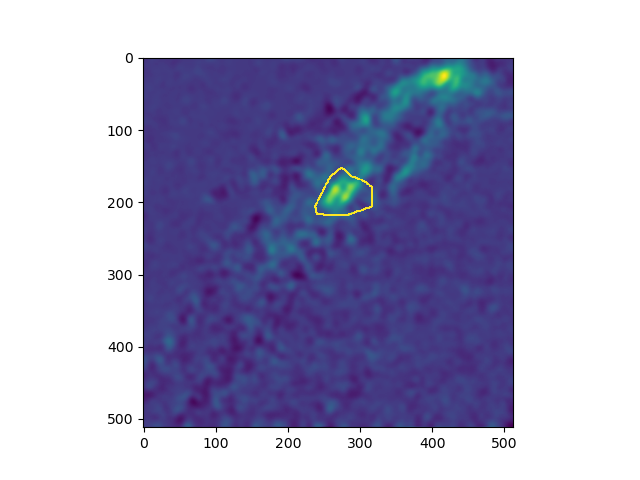

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210715-1-Iav-tdt-7F_00019GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 5    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


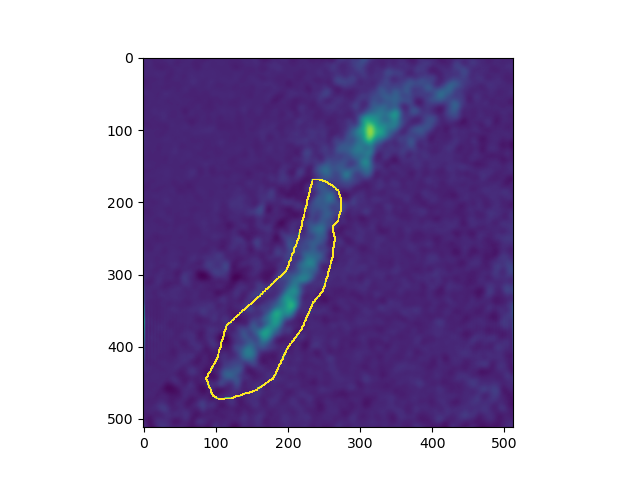

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


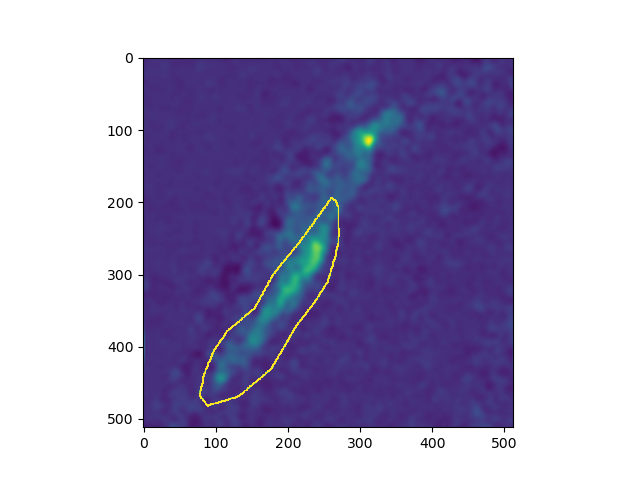

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


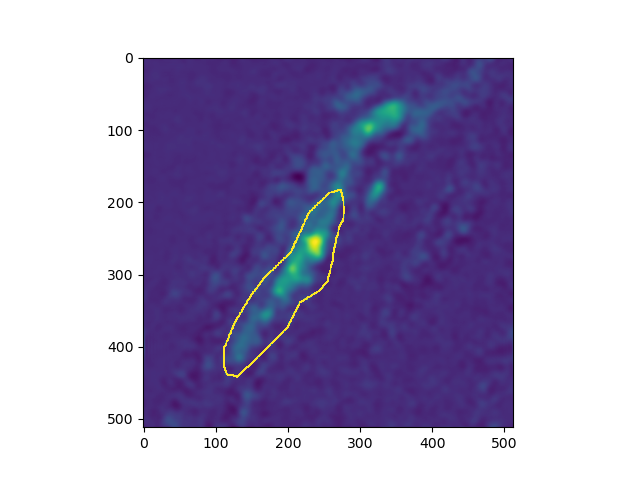

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


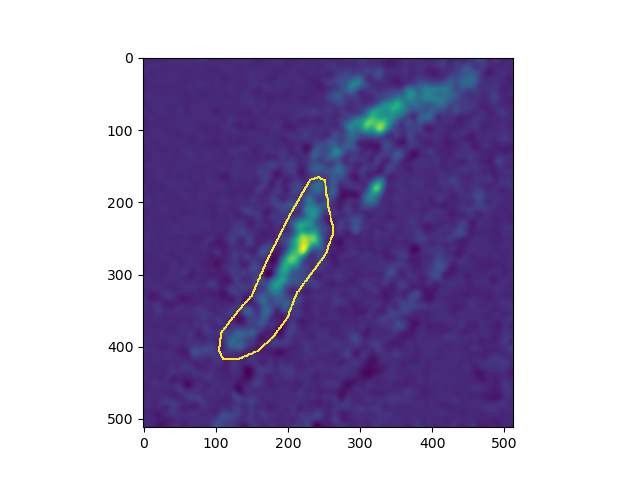

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


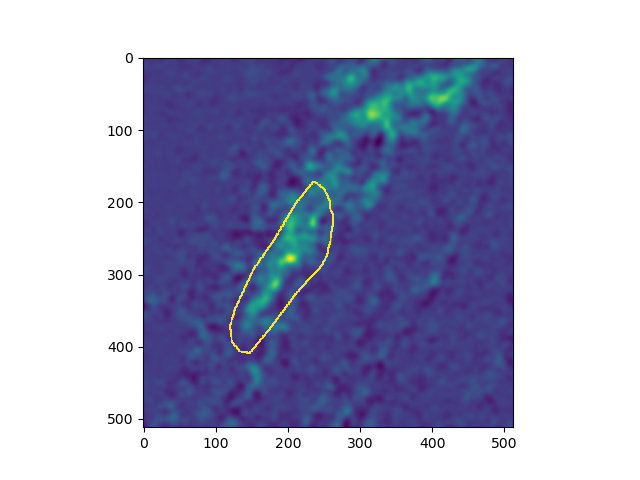

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


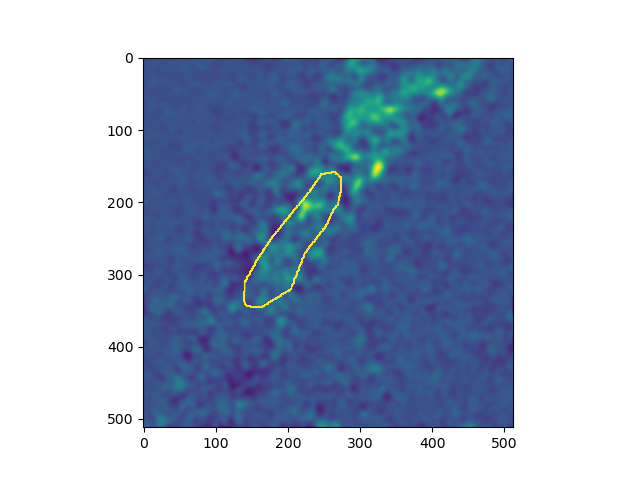

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  5


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 6    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


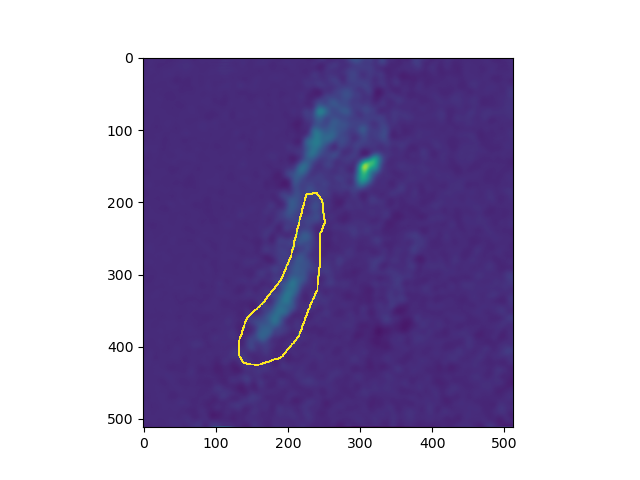

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


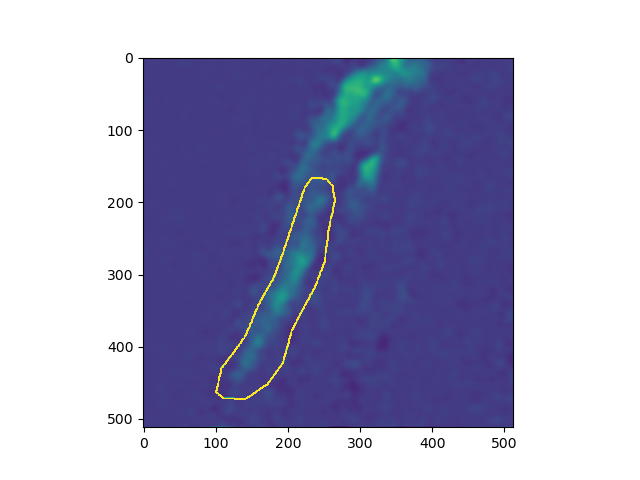

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


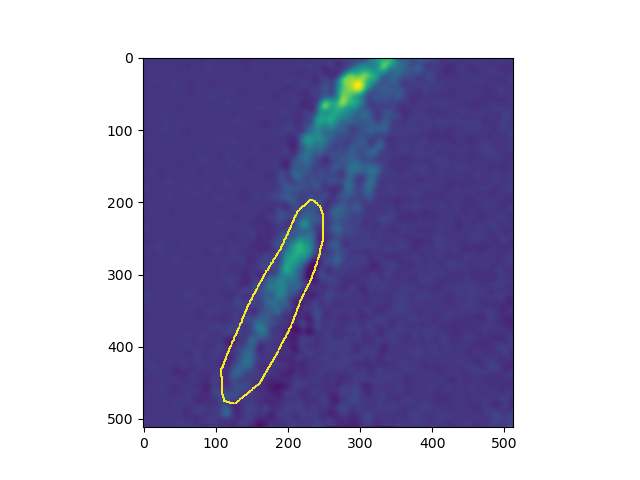

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


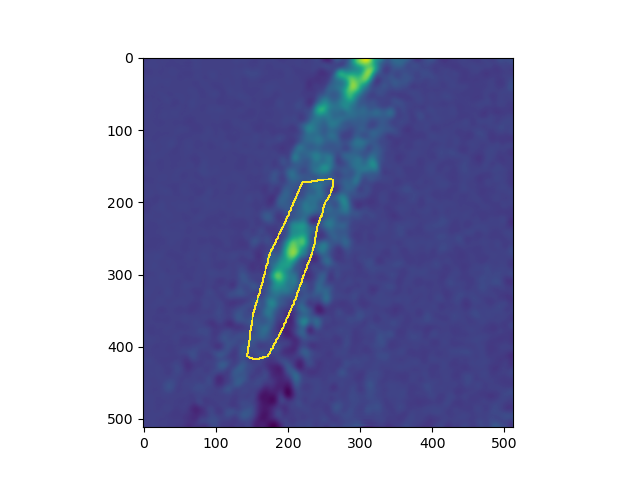

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


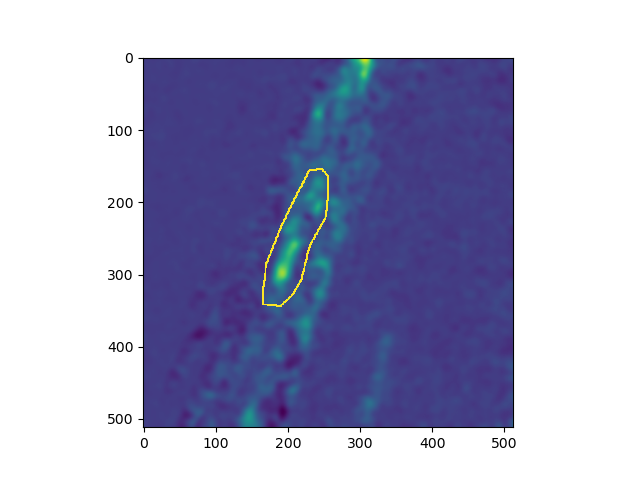

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


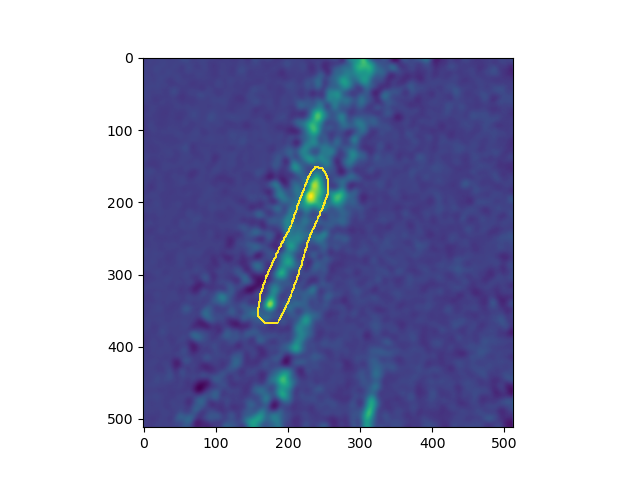

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210720-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  6


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 7    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210722-4-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


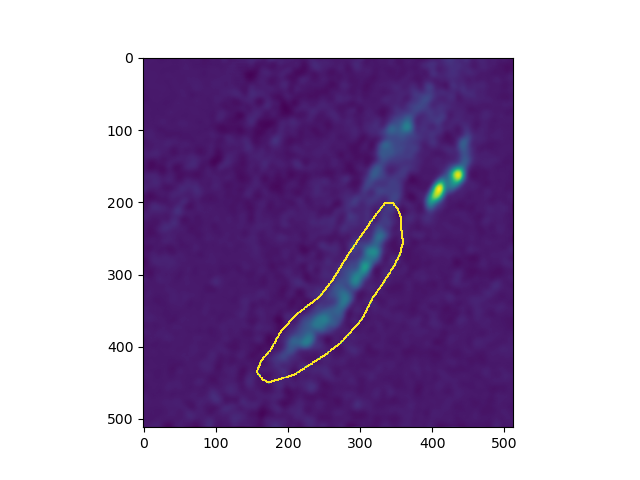

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


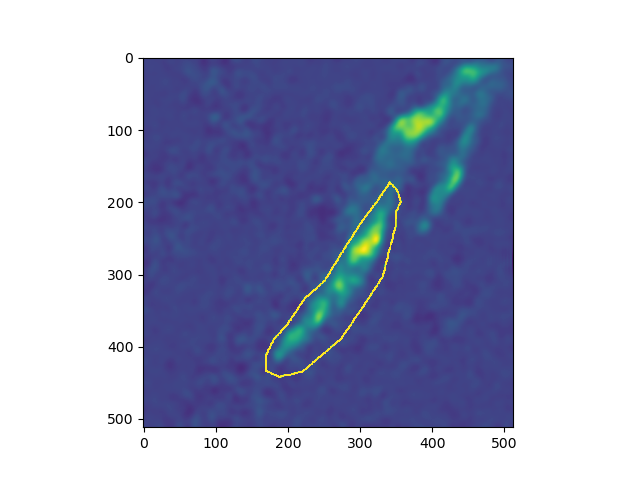

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


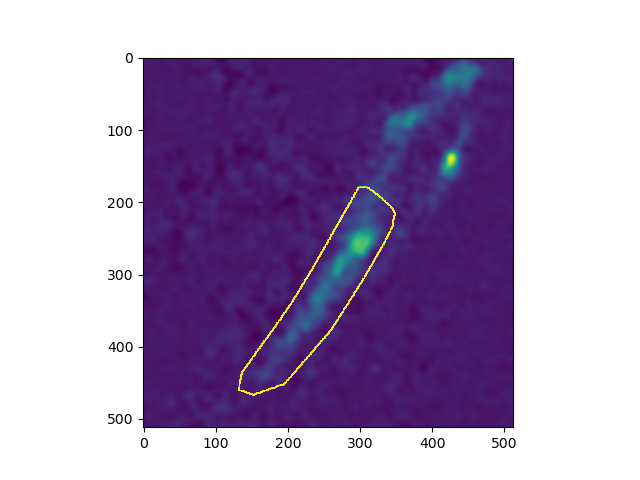

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


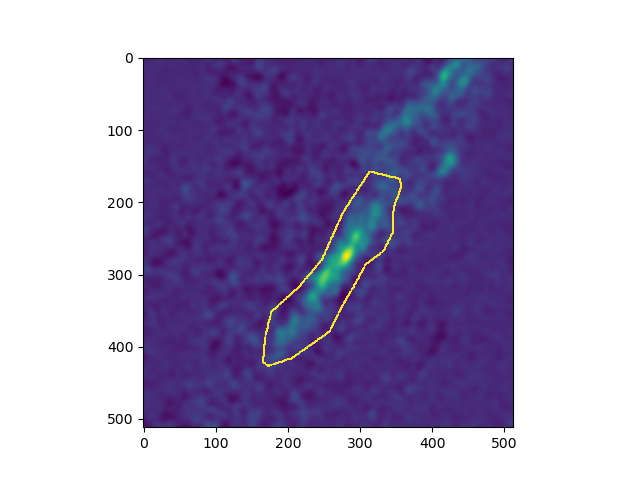

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


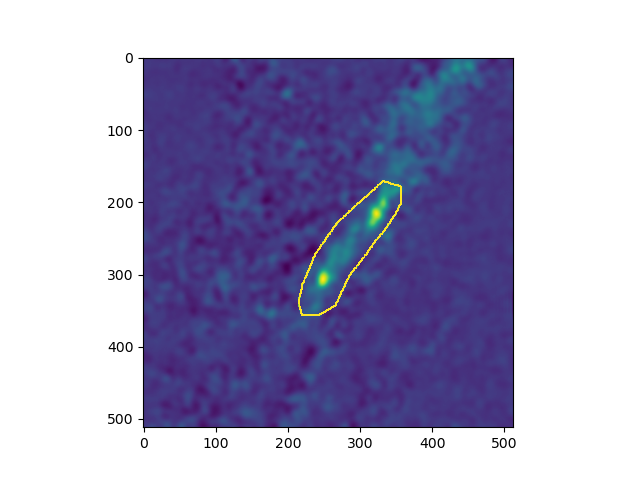

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


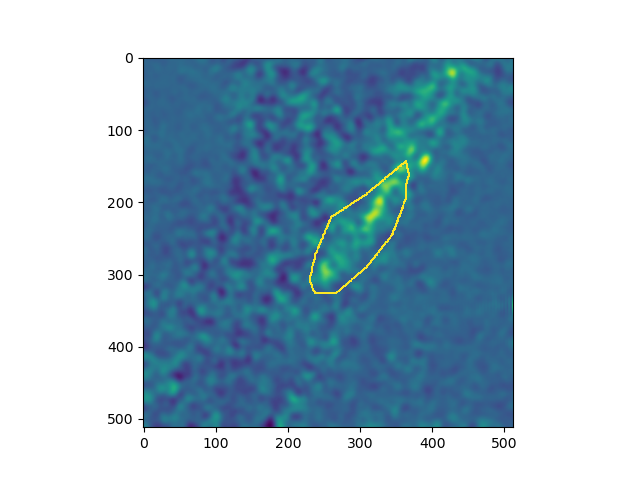

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210722-4-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  7


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 8    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210723-2-Iav-tdt-7F_00007GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


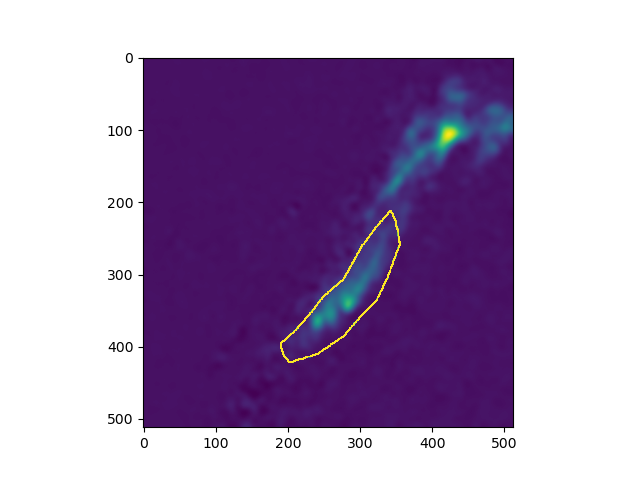

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


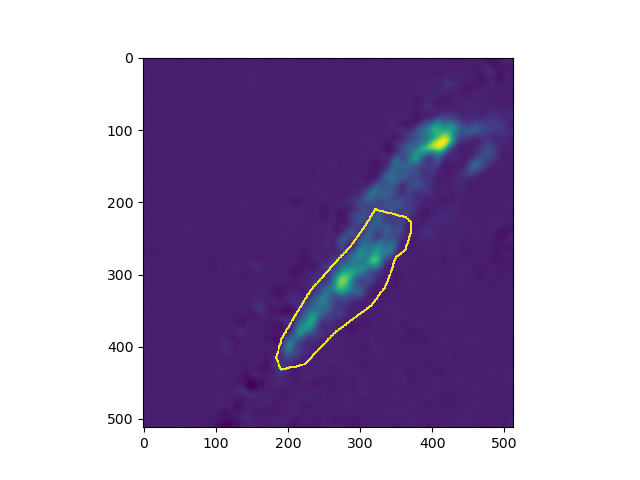

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


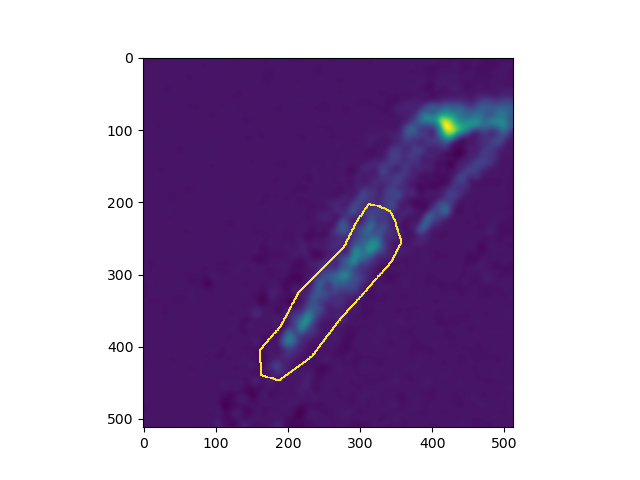

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


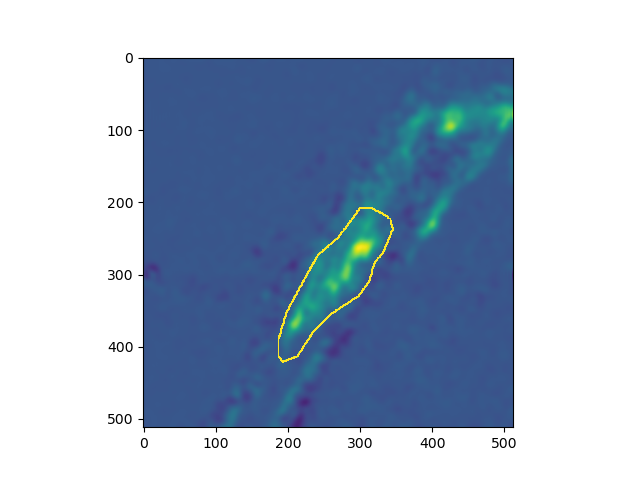

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


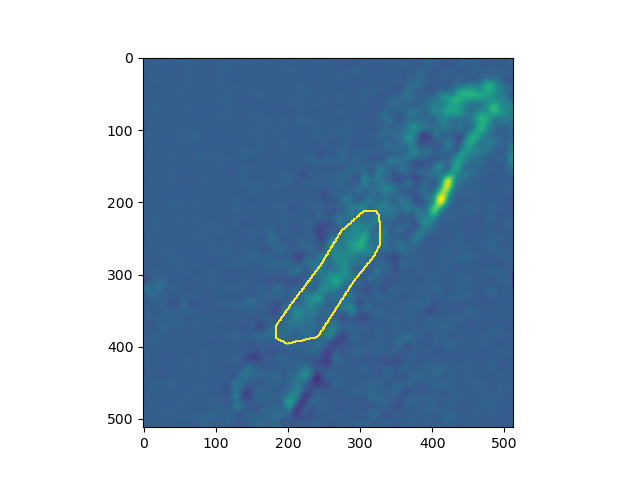

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


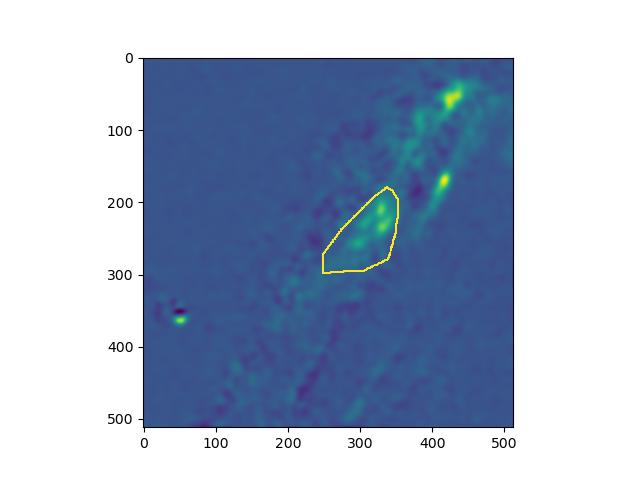

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210723-2-Iav-tdt-7F_00007GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  8


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 9    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210811-1-Iav-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


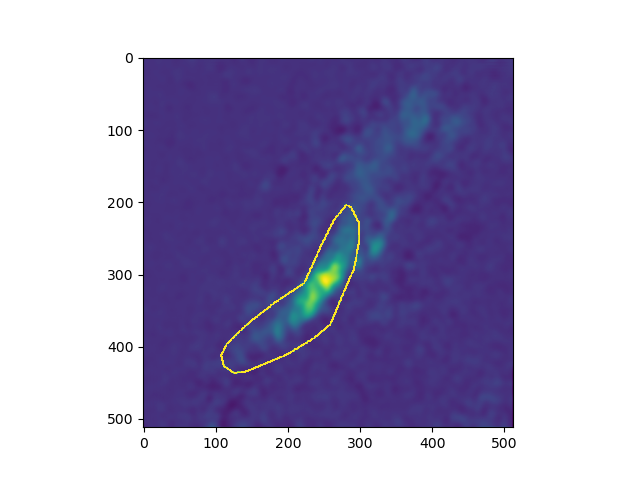

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


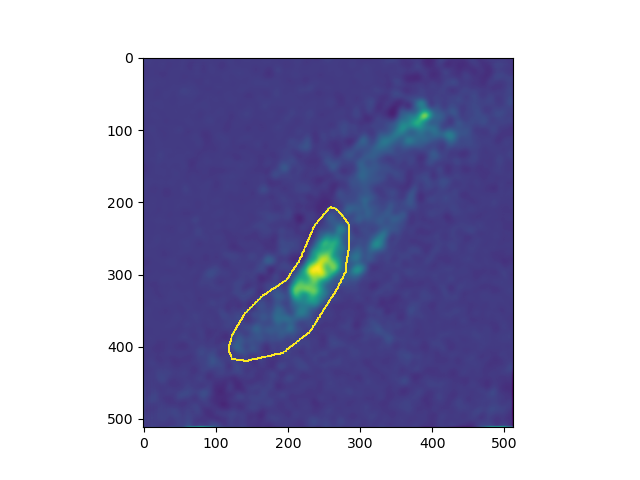

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


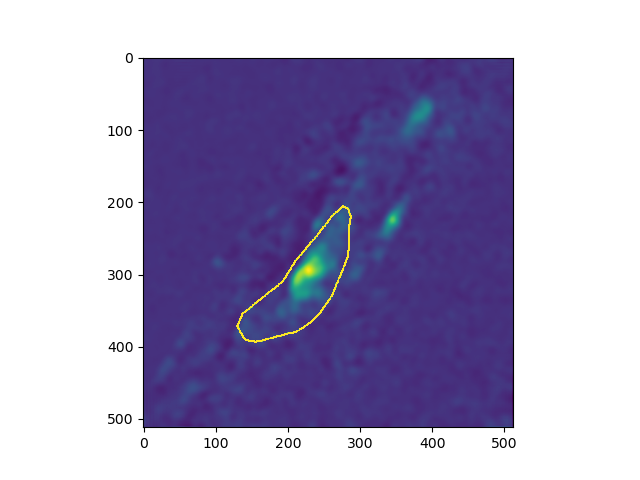

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


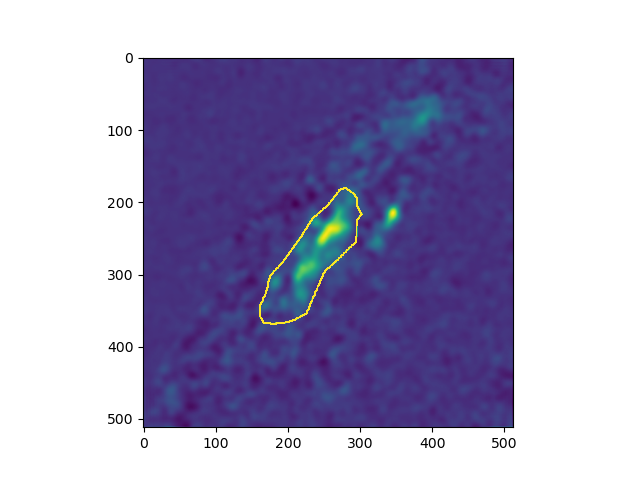

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


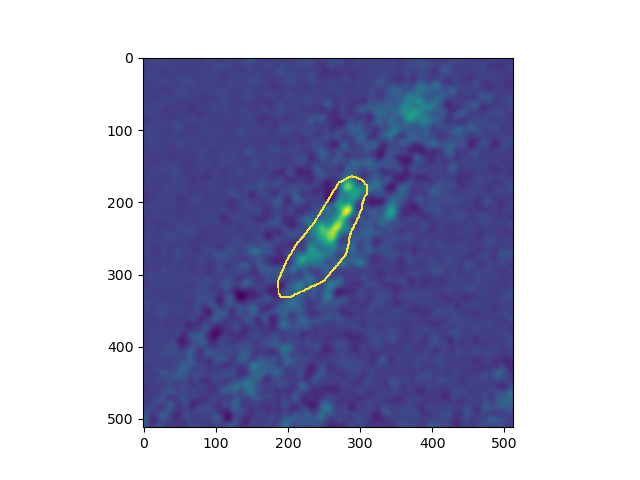

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


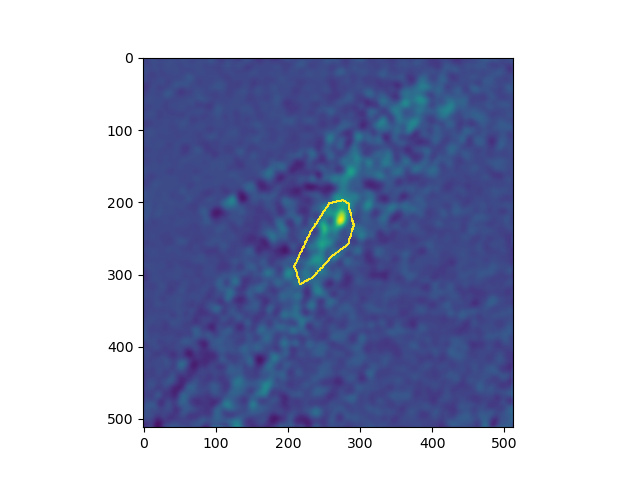

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210811-1-Iav-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  9


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 10    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210811-2-Iav-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


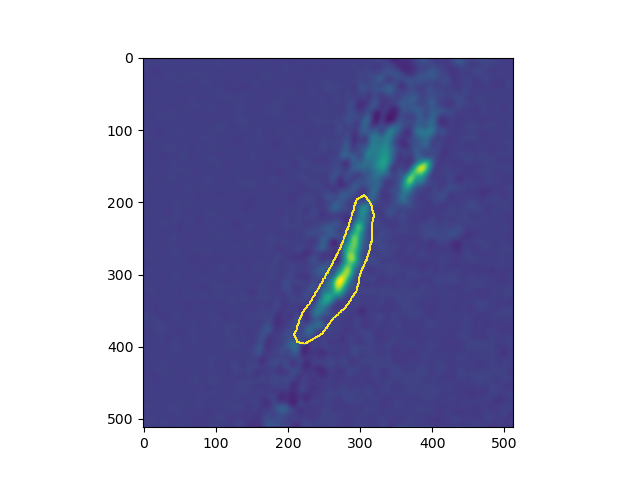

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


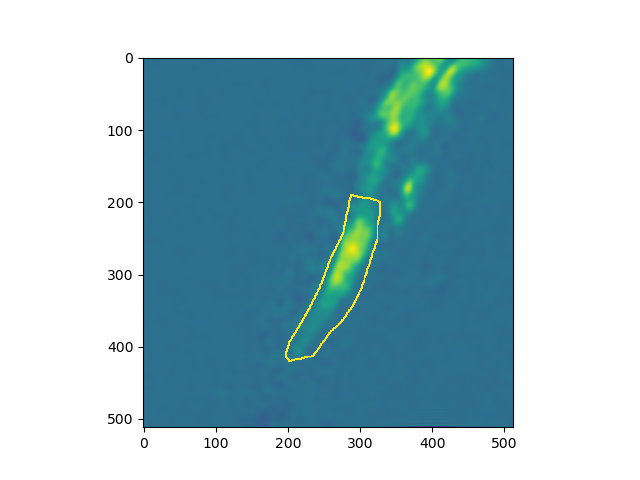

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


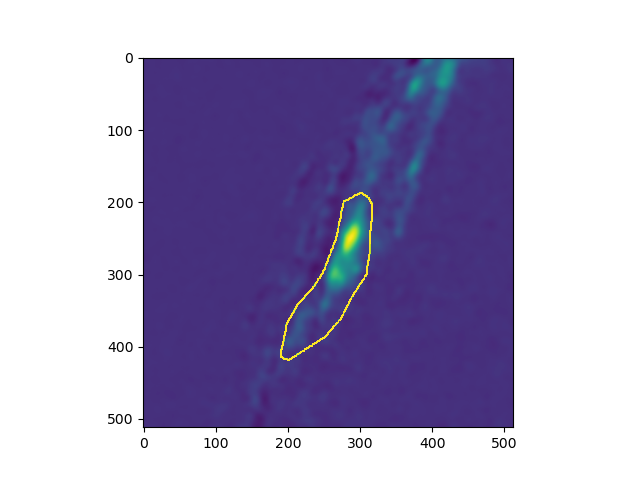

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


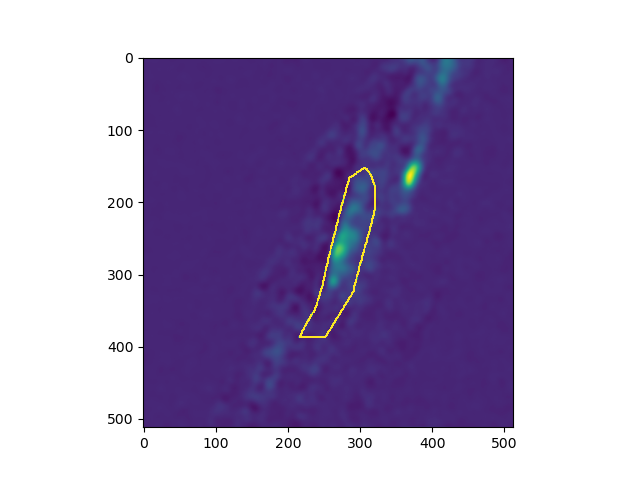

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


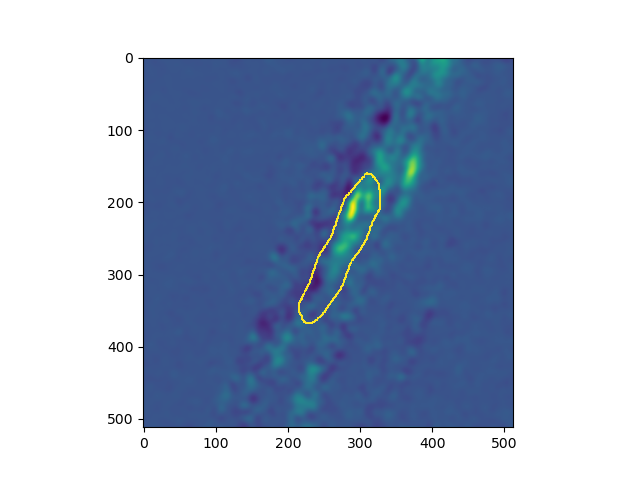

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


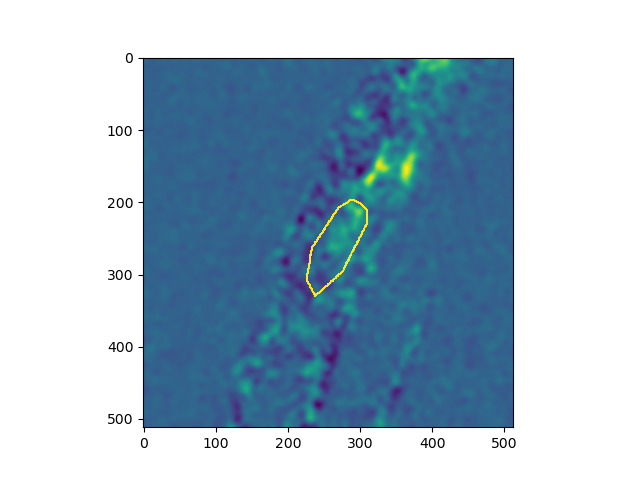

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210811-2-Iav-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  10


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 11    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


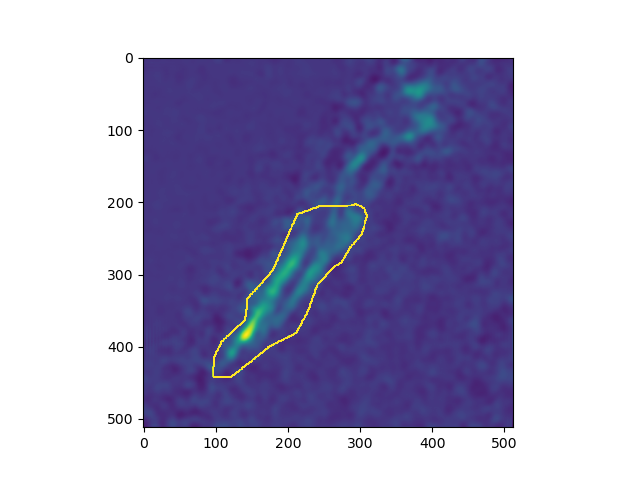

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


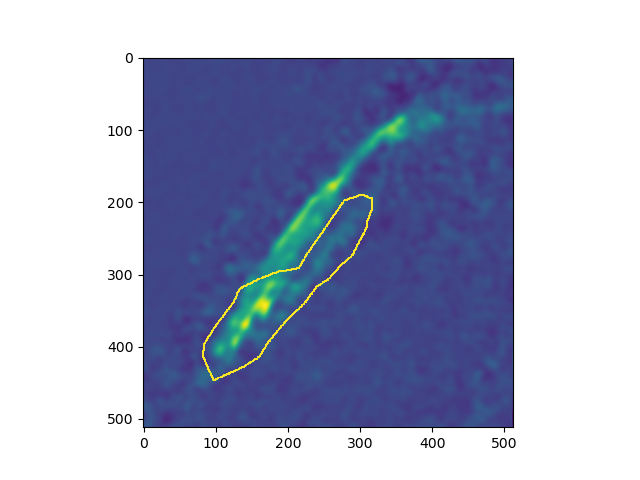

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


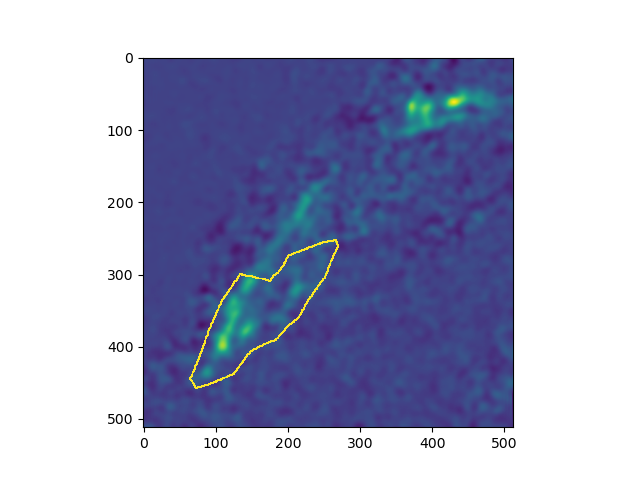

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


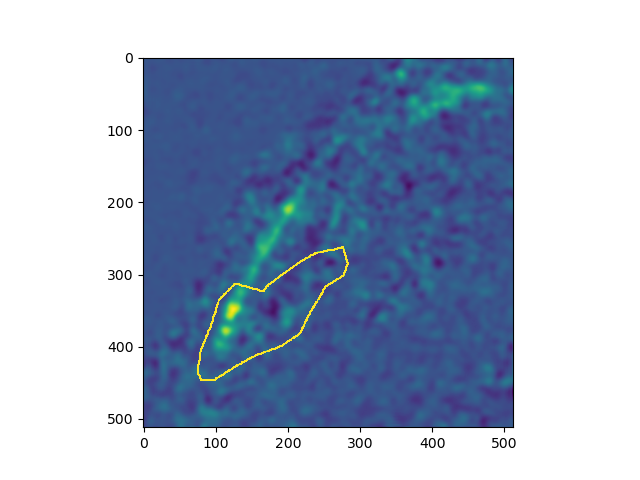

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


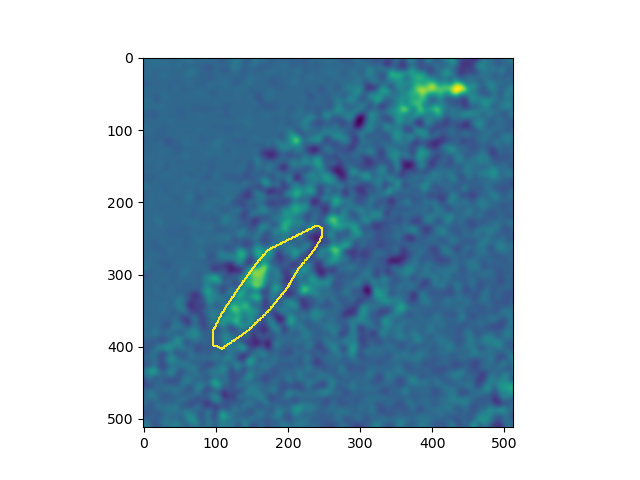

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


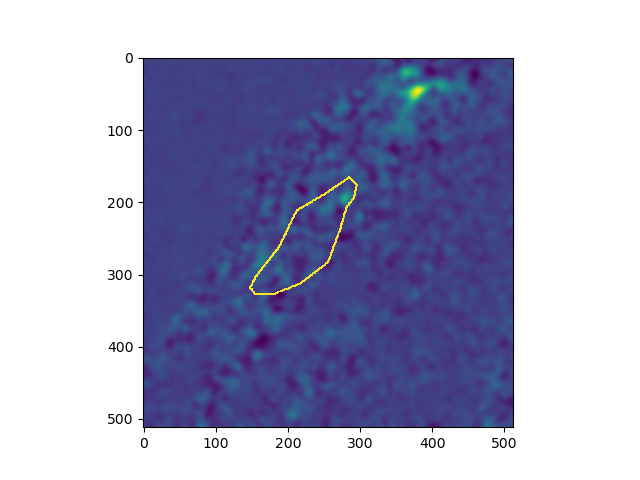

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  11


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 12    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


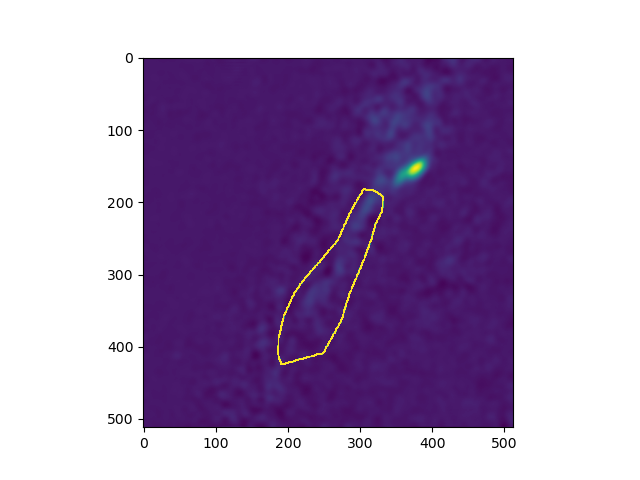

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


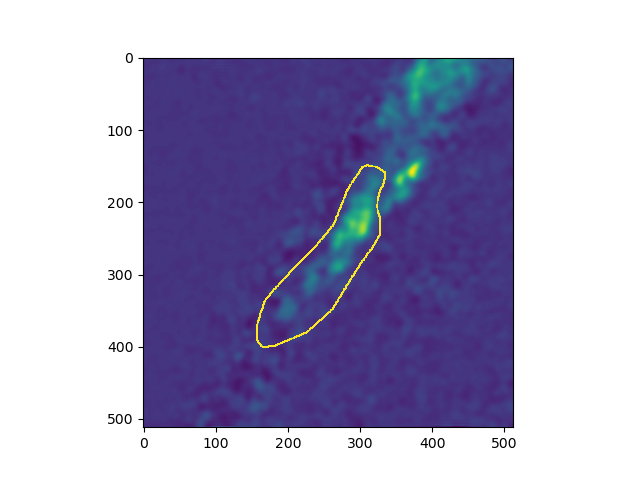

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


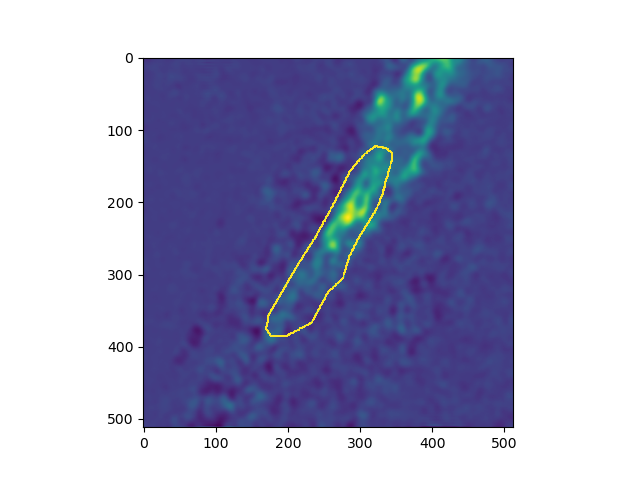

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


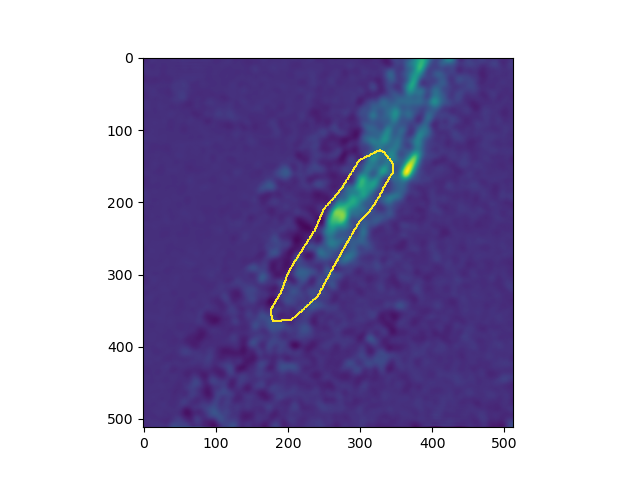

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


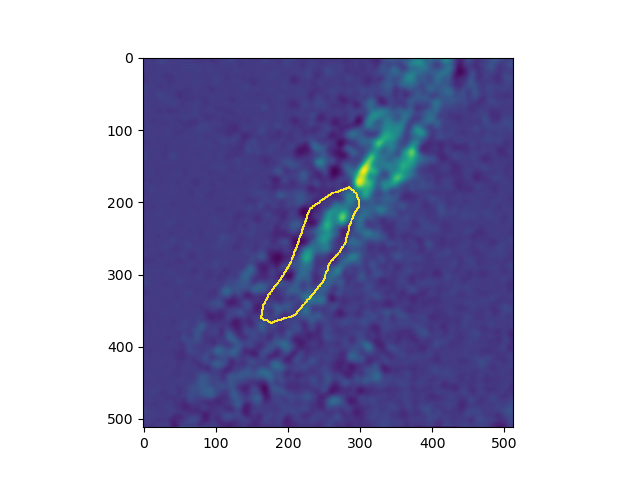

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


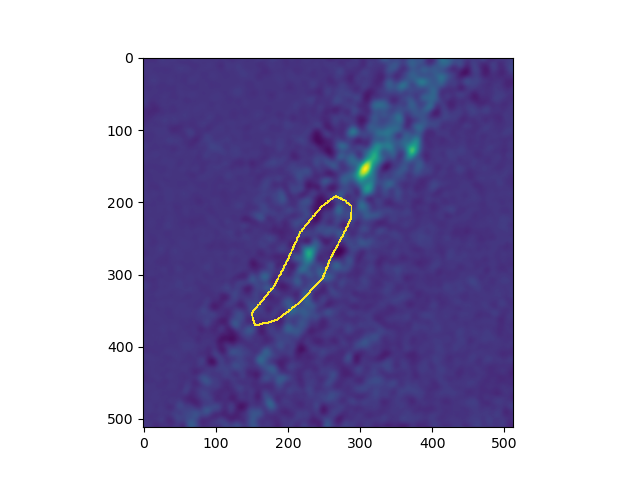

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  12


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 13    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-3-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


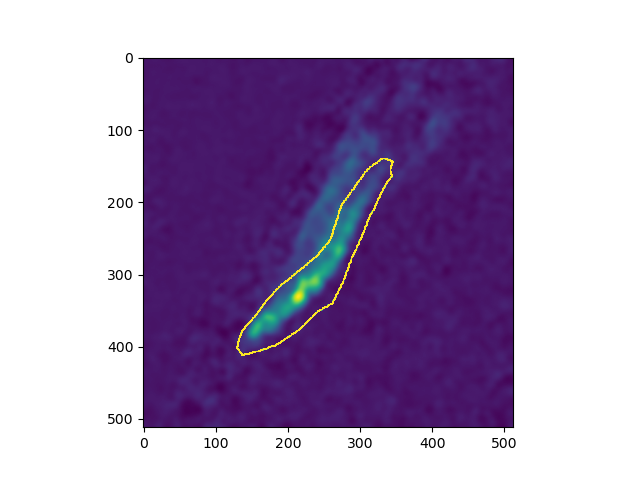

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


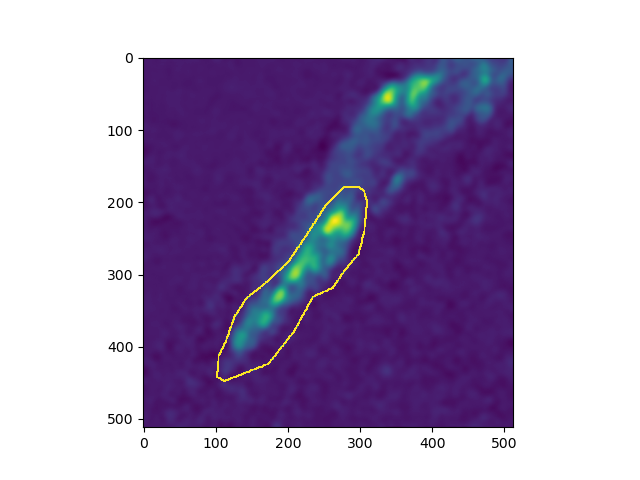

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


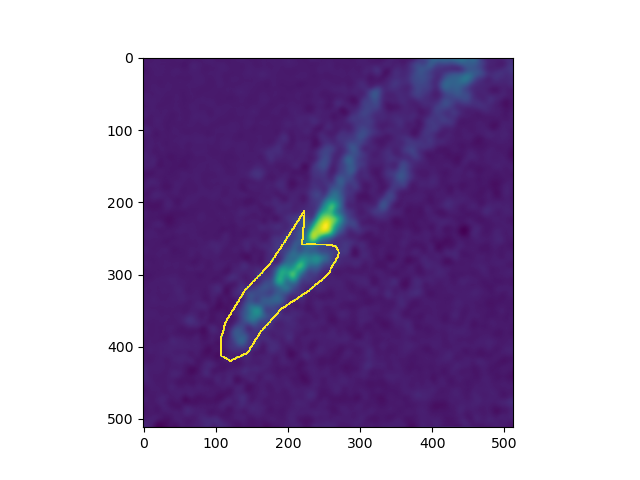

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


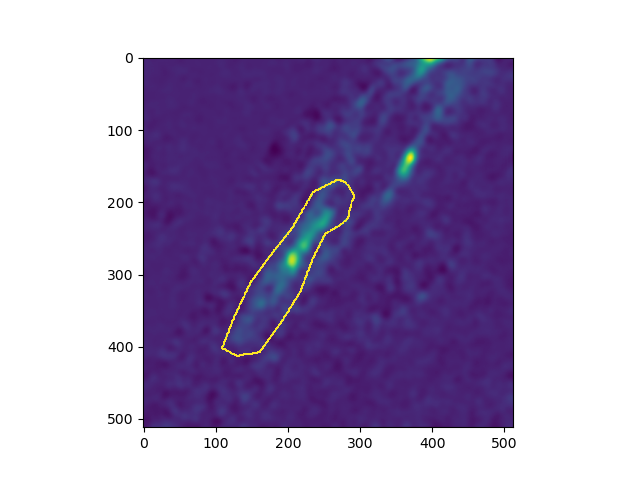

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


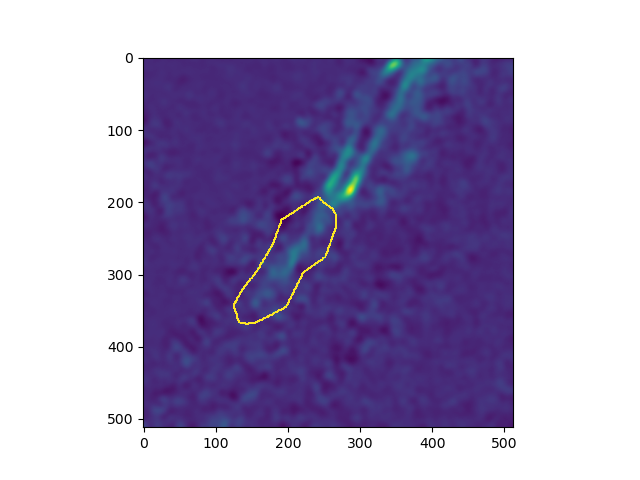

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


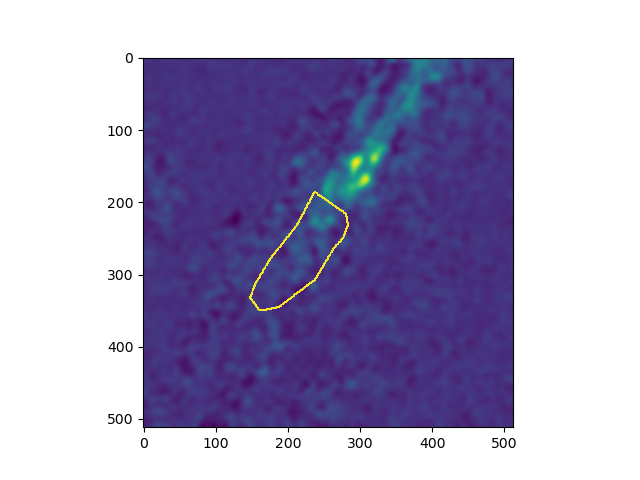

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-3-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  13


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 14    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-4-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


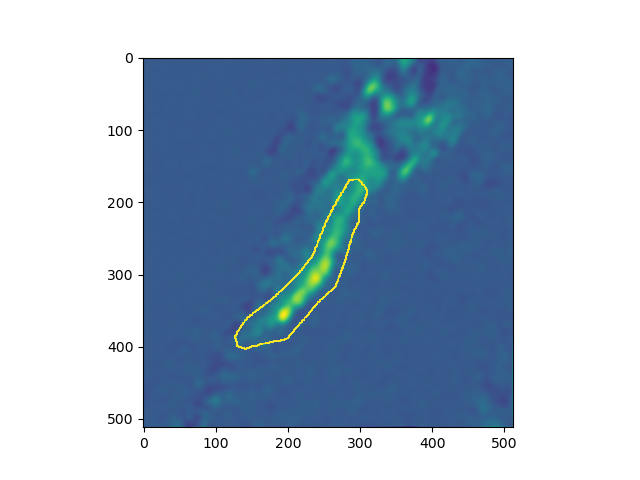

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


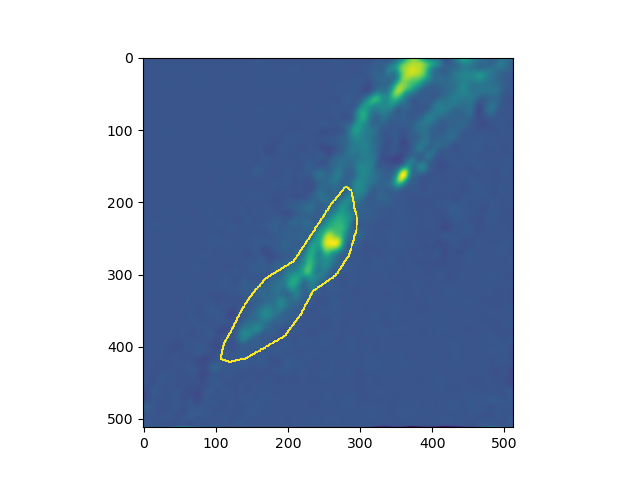

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


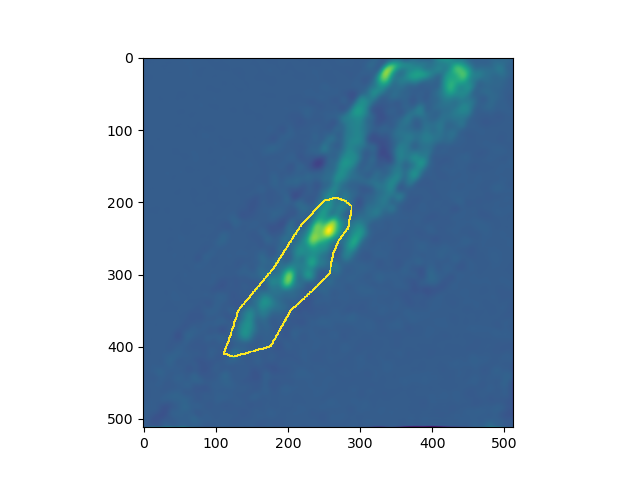

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


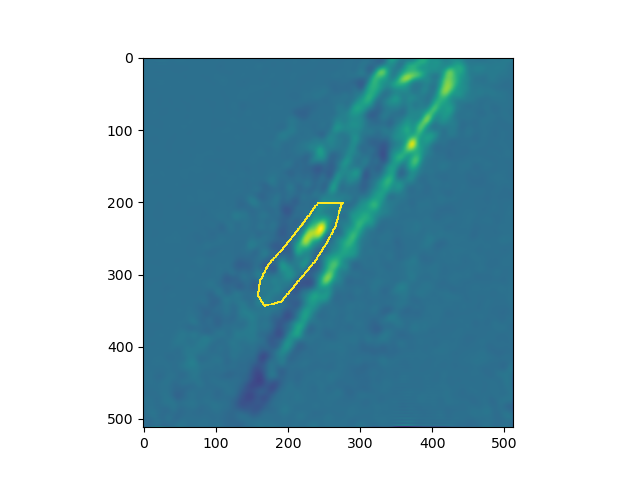

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


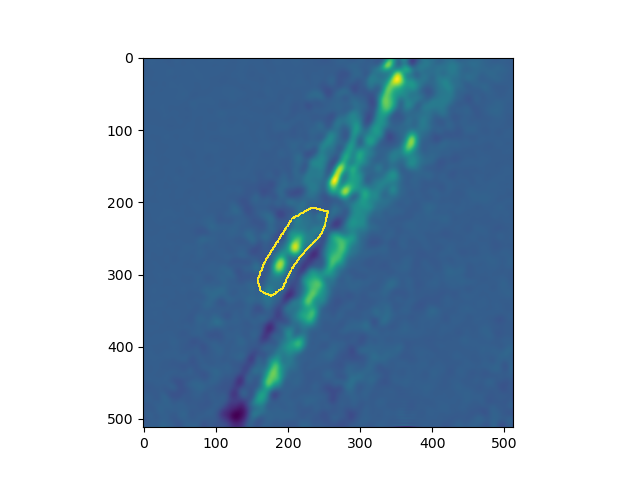

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


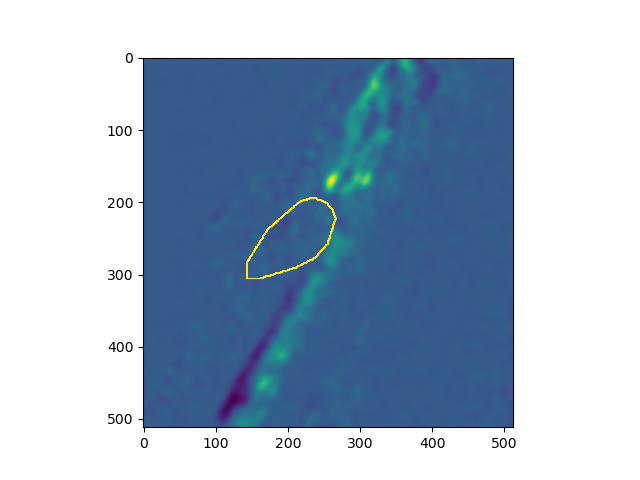

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210816-4-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  14


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 15    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


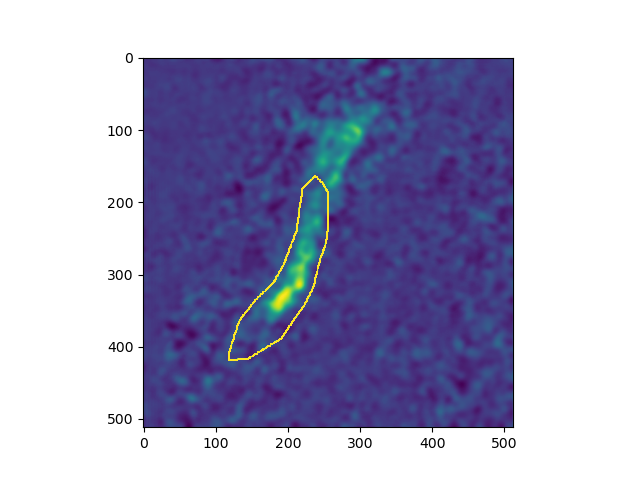

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


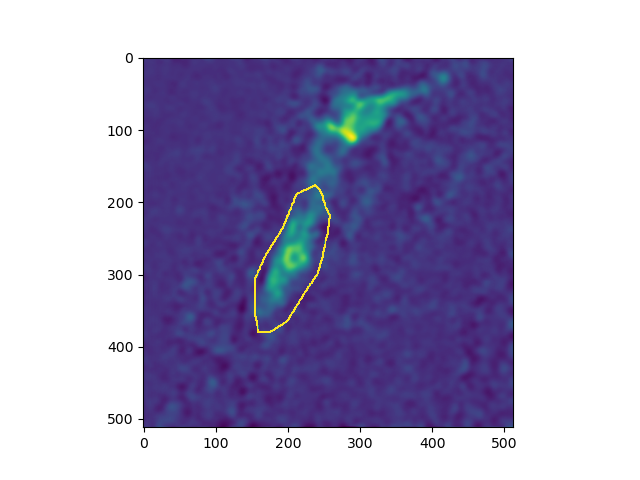

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


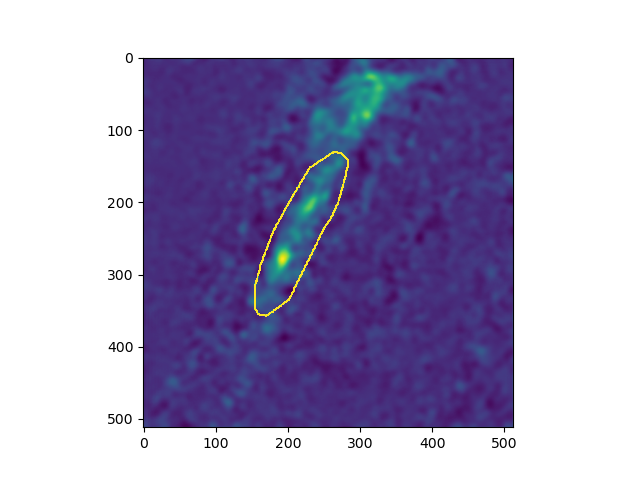

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


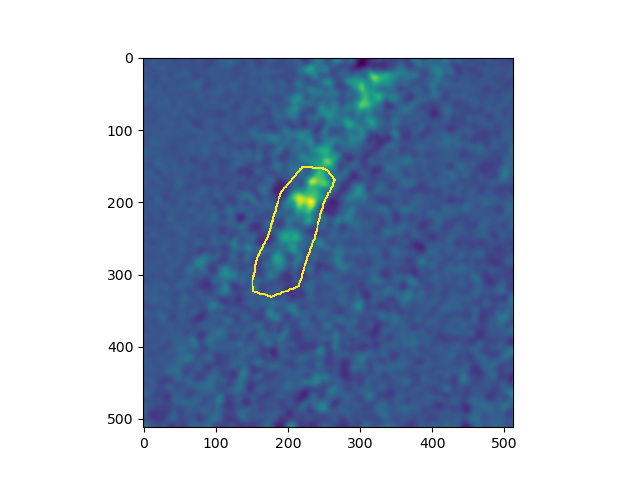

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


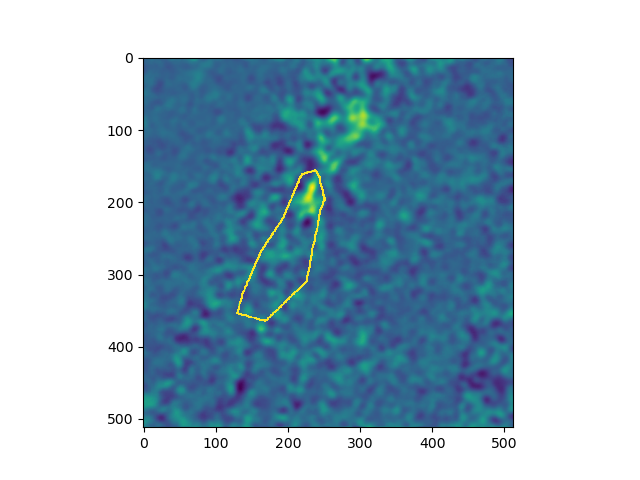

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


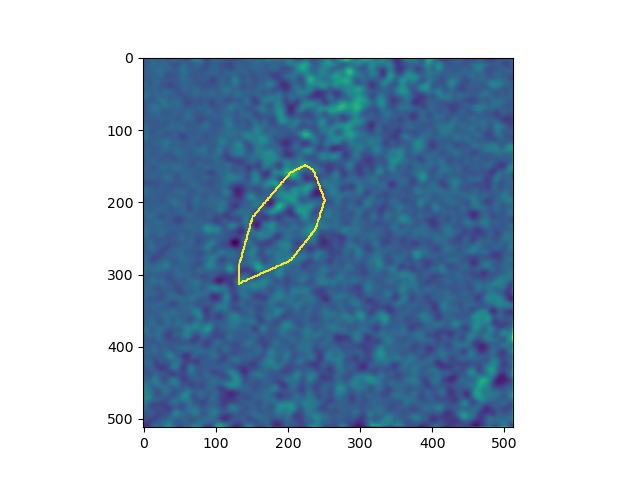

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-1-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  15


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 16    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


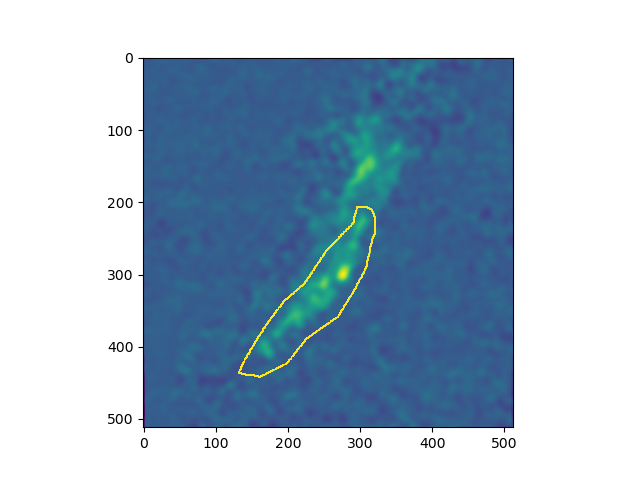

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


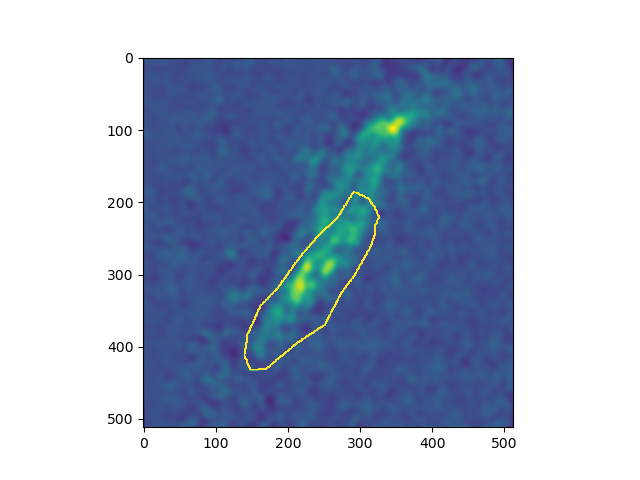

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


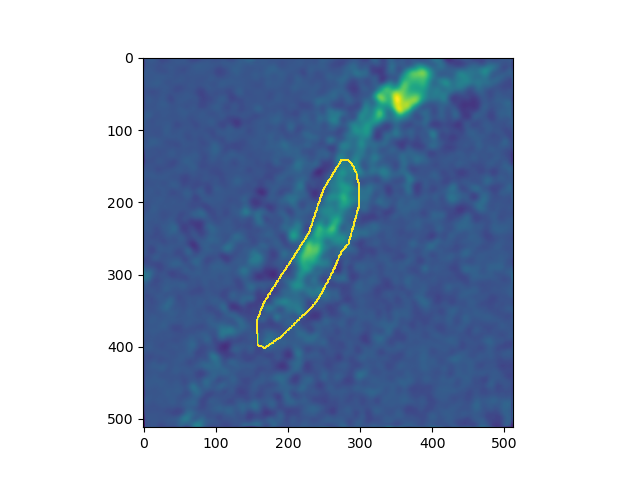

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


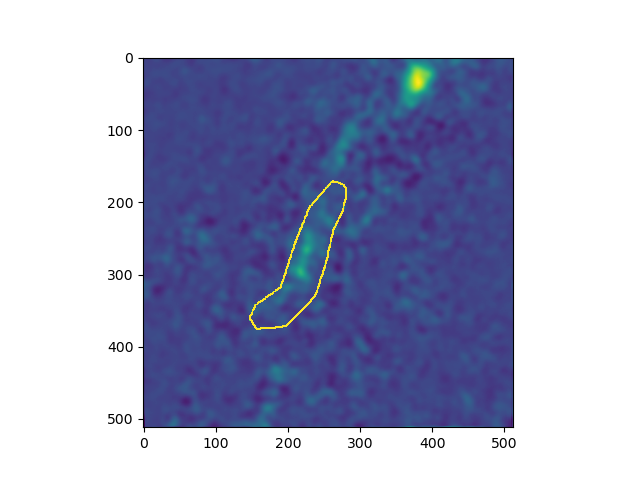

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


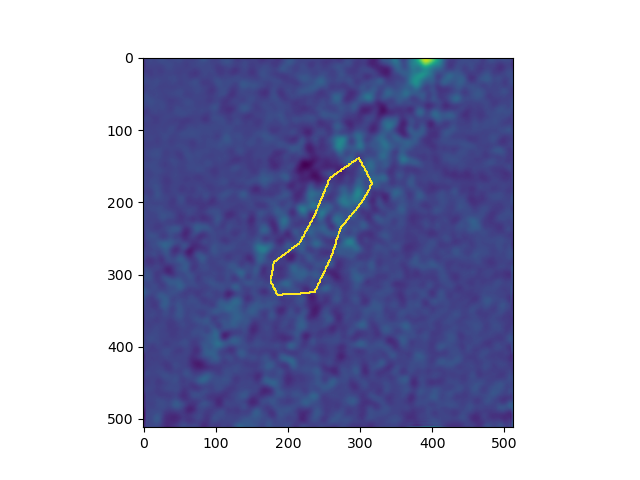

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


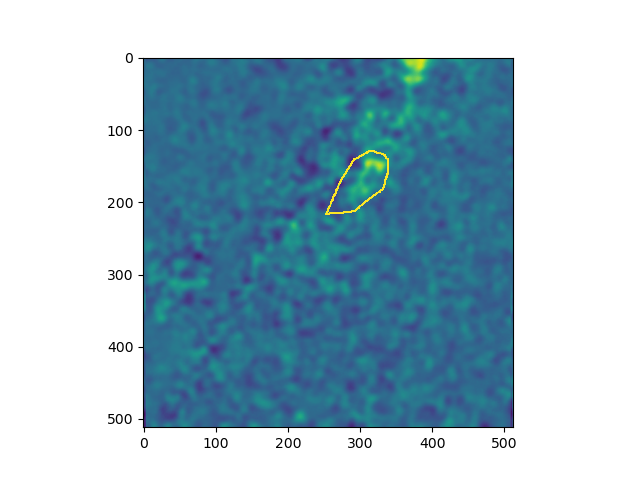

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-2-Iav-tdt-7F_00004GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  16


### Move on to the next trial

In [ ]:
#load the merged maps.
trial_number = 17    

#initialize ROI_masks
ROI_masks=np.zeros((base_gcamp_all.shape[0],base_gcamp_all.shape[1],base_gcamp_all.shape[2]),dtype=np.uint8)

#load all the response maps
with open(maps_path_sorted[trial_number], "rb") as f:
    [average_tdTomato_all,average_gcamp_all,base_tdTomato_all, base_gcamp_all, ratio_response_all, ratio_baseline_all, DF_F_map_all, DR_R_map_all]=pickle.load(f)
    
#    
print(maps_path_sorted[trial_number])

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-4-Iav-tdt-7F_00008GCaMP_Filtered_Zs_registered_Zs_maps


### Go through each map and select ROI for each one

select the ROI


<IPython.core.display.Javascript object>


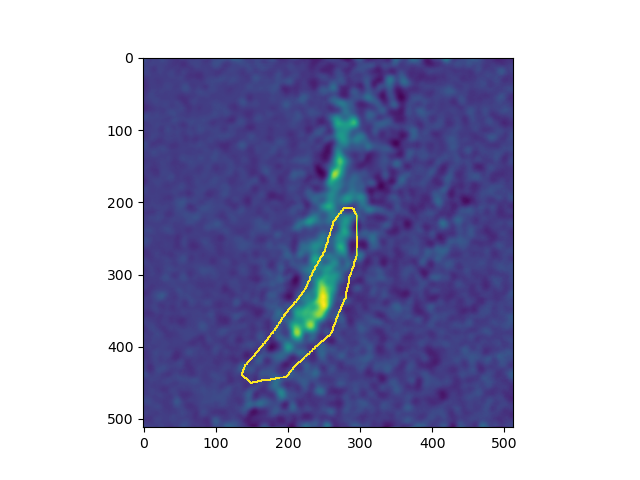

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=0
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


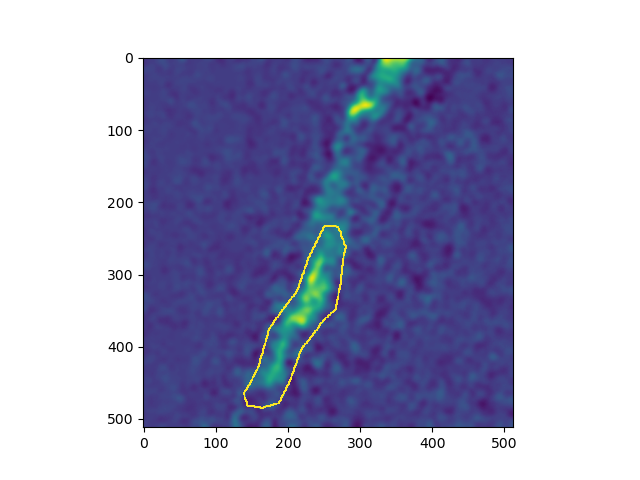

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=1
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


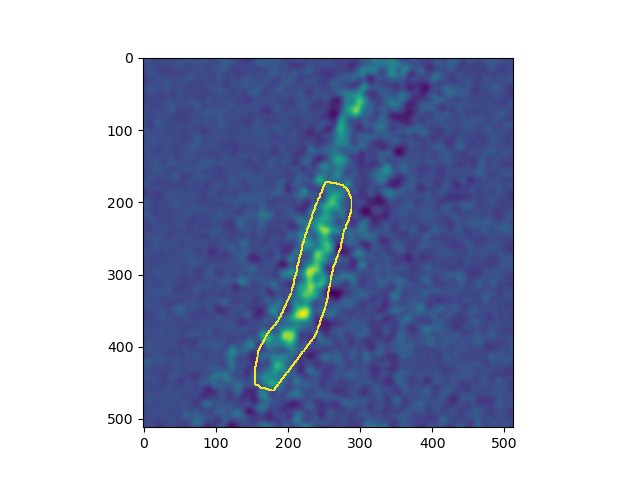

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=2
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


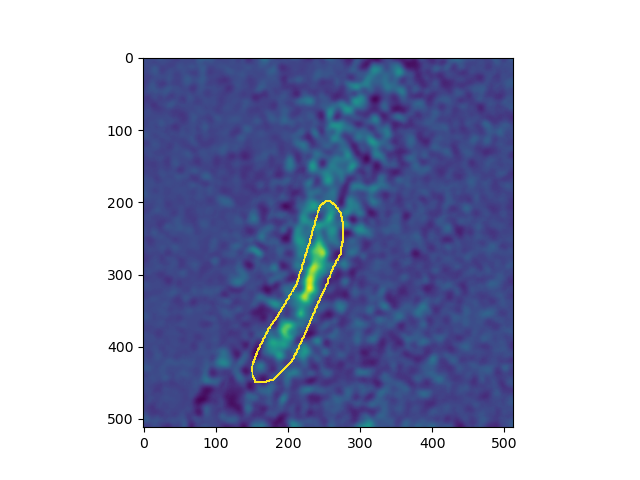

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=3
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


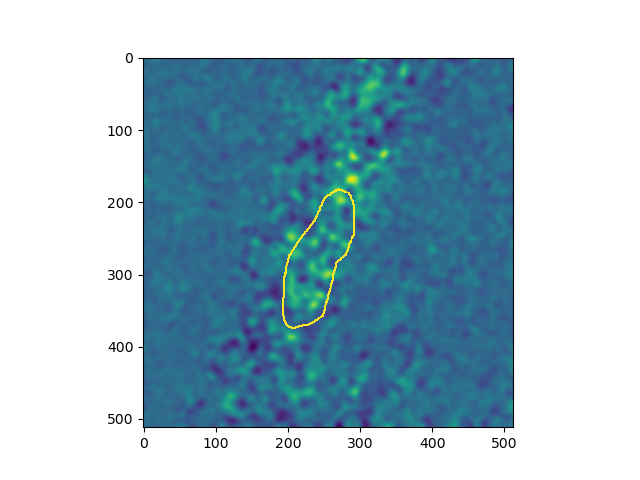

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=4
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



select the ROI


<IPython.core.display.Javascript object>


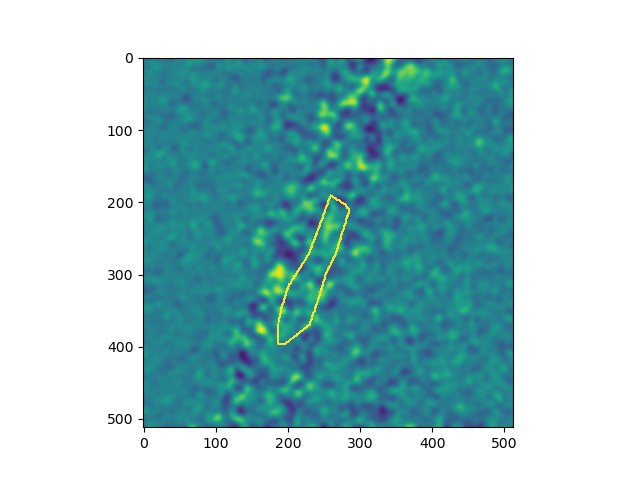

Button(description='Disconnect mpl', style=ButtonStyle())

In [ ]:
z_level=5
#select ROI
print('select the ROI')
roi_polygon=bbox_select(DF_F_map_all[z_level,:,:])

In [ ]:
#Use the manually selected polygon to make the mask
arr1 = np.array([roi_polygon.selected_points],'int')
mask1 = cv2.fillPoly(np.zeros((base_gcamp_all.shape[1],base_gcamp_all.shape[2]),np.uint8),arr1,[1,1,1])

ROI_masks[z_level,:,:]=mask1



### Convert to logical array and save the ROI_masks

In [ ]:
ROI_masks=ROI_masks==1

outfile=maps_path_sorted[trial_number]+"_ROI_Z"

with open(outfile, "wb") as f:
    pickle.dump(ROI_masks,f)
    
print(outfile)
print("trial_number = ", trial_number)

/media/tuthill-lab/NewDisk/Data/club_vibration/ROI_selection3/Copy of 20210823-4-Iav-tdt-7F_00008GCaMP_Filtered_Zs_registered_Zs_maps_ROI_Z
trial_number =  17
